<a href="https://colab.research.google.com/github/shicong0720/A-POI-Based-Machine-Learning-Method-in-Predicting-Health/blob/main/09_26_Data_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Load Data


Load data from the query and CDC; remove obvious outliers.




In [ ]:
import csv
import os
import numpy as np
import pandas as pd
import random
from google.colab import drive
import seaborn as sns
from matplotlib import pyplot
import seaborn as sns
import math
!pip install geopandas
import geopandas as gpd
!pip install contextily==1.0rc2
import contextily as ctx
!pip install Scipy

     |████████████████████████████████| 1.0 MB 5.1 MB/s 
     |████████████████████████████████| 6.3 MB 20.9 MB/s 
     |████████████████████████████████| 15.4 MB 39 kB/s 
     |████████████████████████████████| 19.3 MB 61.0 MB/s 


In [ ]:
drive.mount('/content/gdrive',force_remount=True)
os.chdir("/content/gdrive/My Drive/big data and city 3/data")

Mounted at /content/gdrive


In [ ]:
alist = []
for filename in os.listdir("/content/gdrive/My Drive/big data and city 3/data"):
    if filename.endswith(".csv"): 
        alist.append(filename)
  

In [ ]:
 print(alist)

['food_bar.csv', 'food_cafe.csv', 'food_restaurant.csv', 'food_fast_food.csv', 'health_clinic.csv', 'health_dentist.csv', 'health_doctors.csv', 'health_hospital.csv', 'health_pharmacy.csv', 'transport_stop_position.csv', 'transport_platform.csv', 'transport_station.csv', 'transport_fuel.csv', 'transport_parking.csv', 'transport_bicycle_parking.csv', 'community_worship.csv', 'community_police.csv', 'community_community_centre.csv', 'community_fire_station.csv', 'community_post_office.csv', 'community_post_box.csv', 'community_waste_basket.csv', 'community_recycling.csv', 'leisure_park.csv', 'leisure_garden.csv', 'leisure_pitch.csv', 'leisure_sports_centre.csv', 'leisure_swimming_pool.csv', 'tourism_attraction.csv', 'tourism_artwork.csv', 'tourism_information.csv', 'tourism_hotel.csv', 'tourism_viewpoint.csv', 'building_apartments.csv', 'building_commercial.csv', 'building_industrial.csv', 'building_retail.csv', 'building_greenhouse.csv', 'building_barn.csv', 'natural_tree.csv', 'natural

In [ ]:
blist = ['food_bar', 'food_cafe', 'food_restaurant', 'food_fast_food', 'health_clinic', 'health_dentist', 'health_doctors', 'health_hospital', 'health_pharmacy', 'transport_stop_position', 'transport_platform', 'transport_station', 'transport_fuel', 'transport_parking', 'transport_bicycle_parking', 'community_worship', 'community_police', 'community_community_centre', 'community_fire_station', 'community_post_office', 'community_post_box', 'community_waste_basket', 'community_recycling', 'leisure_park', 'leisure_garden', 'leisure_pitch', 'leisure_sports_centre', 'leisure_swimming_pool', 'tourism_attraction', 'tourism_artwork', 'tourism_information', 'tourism_hotel', 'tourism_viewpoint', 'building_apartments', 'building_commercial', 'building_industrial', 'building_retail', 'building_greenhouse', 'building_barn', 'nature_tree', 'nature_water', 'nature_wood', 'nature_peak', 'nature_sand', 'nature_coastline', 'nature_wetland','nature_cliff', 'shop_clothes', 'shop_supermarket', 'shop_bakery']

In [ ]:
alist = ['food_bar.csv', 'food_cafe.csv', 'food_restaurant.csv', 'food_fast_food.csv', 'health_clinic.csv', 'health_dentist.csv', 'health_doctors.csv', 'health_hospital.csv', 'health_pharmacy.csv', 'transport_stop_position.csv', 'transport_platform.csv', 'transport_station.csv', 'transport_fuel.csv', 'transport_parking.csv', 'transport_bicycle_parking.csv', 'community_worship.csv', 'community_police.csv', 'community_community_centre.csv', 'community_fire_station.csv', 'community_post_office.csv', 'community_post_box.csv', 'community_waste_basket.csv', 'community_recycling.csv', 'leisure_park.csv', 'leisure_garden.csv', 'leisure_pitch.csv', 'leisure_sports_centre.csv', 'leisure_swimming_pool.csv', 'tourism_attraction.csv', 'tourism_artwork.csv', 'tourism_information.csv', 'tourism_hotel.csv', 'tourism_viewpoint.csv', 'building_apartments.csv', 'building_commercial.csv', 'building_industrial.csv', 'building_retail.csv', 'building_greenhouse.csv', 'building_barn.csv', 'natural_tree.csv', 'natural_water.csv', 'natural_wood.csv', 'natural_peak.csv', 'natural_sand.csv', 'natural_coastline.csv', 'natural_wetland.csv', 'natural_cliff.csv', 'shop_clothes.csv', 'shop_supermarket.csv', 'shop_bakery.csv']


In [ ]:
poidata = []
for i in alist:
  data = pd.read_csv(i,header=None)
  poidata.append(data)
for i in range(len(poidata)-1):
  poidata[0] = pd.merge(poidata[0], poidata[i + 1][1], right_index=True, left_index=True, )
s = poidata[0]
count = s.iloc[: , 1:]


In [ ]:
os.chdir("/content/gdrive/My Drive/big data and city 3")
plotboundary = gpd.read_file('plotboudary.geojson',header=None)


In [ ]:
count.columns = blist
count

,food_bar,food_cafe,food_restaurant,food_fast_food,health_clinic,health_dentist,health_doctors,health_hospital,health_pharmacy,transport_stop_position,transport_platform,transport_station,transport_fuel,transport_parking,transport_bicycle_parking,community_worship,community_police,community_community_centre,community_fire_station,community_post_office,community_post_box,community_waste_basket,community_recycling,leisure_park,leisure_garden,leisure_pitch,leisure_sports_centre,leisure_swimming_pool,tourism_attraction,tourism_artwork,tourism_information,tourism_hotel,tourism_viewpoint,building_apartments,building_commercial,building_industrial,building_retail,building_greenhouse,building_barn,nature_tree,nature_water,nature_wood,nature_peak,nature_sand,nature_coastline,nature_wetland,nature_cliff,shop_clothes,shop_supermarket,shop_bakery
0,1,2,7,2,0,0,0,0,0,13,16,0,1,15,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,1,3,0,0,0,0,0,0,0,0,0,0,0,2,2
1,0,2,3,1,1,0,0,0,0,15,13,0,2,38,0,2,0,0,1,1,0,0,0,3,9,10,1,0,0,0,0,0,0,0,1,1,1,0,0,183,0,0,0,1,2,1,0,0,0,0
2,1,1,5,0,0,0,0,0,2,23,20,0,2,16,0,1,0,0,0,1,0,0,0,3,1,9,0,3,0,2,0,4,0,2,38,0,0,0,0,1,1,0,0,0,0,0,0,0,2,0
3,0,0,6,0,0,0,0,0,0,13,9,0,0,2,0,0,0,1,1,0,0,0,0,1,0,1,0,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,1,0,1,0,0,0,0,0,0,0,8,0,0,8,0,2,0,0,0,1,0,0,0,1,0,3,0,29,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12583,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,5,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
12584,0,0,1,0,0,1,0,0,0,0,0,0,4,3,0,3,0,0,1,0,0,0,0,2,0,7,0,0,0,0,0,2,0,0,0,2,0,0,0,0,10,0,0,0,0,1,0,0,1,0
12585,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4,0,1,1,0,0,0,0,3,0,0,1,0,0,0,0,0,0,13,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1
12586,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
count['sum'] = count.sum(axis=1)

In [ ]:
count['sum'].describe()

count    12588.000000
mean        82.507070
std        186.571218
min          0.000000
25%         12.000000
50%         34.000000
75%         89.000000
max       4516.000000
Name: sum, dtype: float64

In [ ]:
plot = plotboundary.merge(count, right_index=True, left_index=True)

In [ ]:
count

,food_bar,food_cafe,food_restaurant,food_fast_food,health_clinic,health_dentist,health_doctors,health_hospital,health_pharmacy,transport_stop_position,transport_platform,transport_station,transport_fuel,transport_parking,transport_bicycle_parking,community_worship,community_police,community_community_centre,community_fire_station,community_post_office,community_post_box,community_waste_basket,community_recycling,leisure_park,leisure_garden,leisure_pitch,leisure_sports_centre,leisure_swimming_pool,tourism_attraction,tourism_artwork,tourism_information,tourism_hotel,tourism_viewpoint,building_apartments,building_commercial,building_industrial,building_retail,building_greenhouse,building_barn,nature_tree,nature_water,nature_wood,nature_peak,nature_sand,nature_coastline,nature_wetland,nature_cliff,shop_clothes,shop_supermarket,shop_bakery,sum
0,1,2,7,2,0,0,0,0,0,13,16,0,1,15,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,1,3,0,0,0,0,0,0,0,0,0,0,0,2,2,70
1,0,2,3,1,1,0,0,0,0,15,13,0,2,38,0,2,0,0,1,1,0,0,0,3,9,10,1,0,0,0,0,0,0,0,1,1,1,0,0,183,0,0,0,1,2,1,0,0,0,0,292
2,1,1,5,0,0,0,0,0,2,23,20,0,2,16,0,1,0,0,0,1,0,0,0,3,1,9,0,3,0,2,0,4,0,2,38,0,0,0,0,1,1,0,0,0,0,0,0,0,2,0,138
3,0,0,6,0,0,0,0,0,0,13,9,0,0,2,0,0,0,1,1,0,0,0,0,1,0,1,0,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,43
4,1,0,1,0,0,0,0,0,0,0,8,0,0,8,0,2,0,0,0,1,0,0,0,1,0,3,0,29,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,56
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12583,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,5,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,17
12584,0,0,1,0,0,1,0,0,0,0,0,0,4,3,0,3,0,0,1,0,0,0,0,2,0,7,0,0,0,0,0,2,0,0,0,2,0,0,0,0,10,0,0,0,0,1,0,0,1,0,38
12585,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4,0,1,1,0,0,0,0,3,0,0,1,0,0,0,0,0,0,13,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,27
12586,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2


In [ ]:
!pip install contextily==1.0rc2
import contextily as ctx

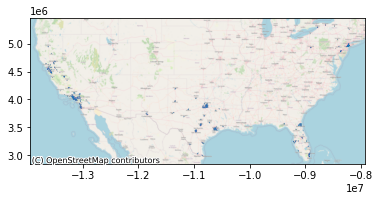

In [ ]:
ax = plotboundary.plot()
ctx.add_basemap(ax, url=ctx.providers.OpenStreetMap.Mapnik)

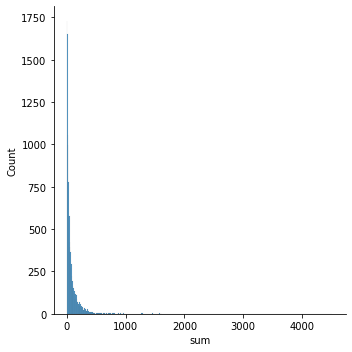

In [ ]:
sns.displot(count, x="sum",height=5);

[Text(0, 0.5, ''), Text(0.5, 0, 'sum of POI')]

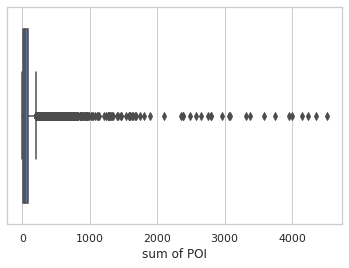

In [ ]:

sns.set_theme(style="whitegrid")

ax = sns.boxplot(x=count["sum"])

ax. set(xlabel= 'sum of POI', ylabel=None)

In [ ]:
count = count[count['sum'] >= 12]

[Text(0, 0.5, ''), Text(0.5, 0, 'Sum of POI')]

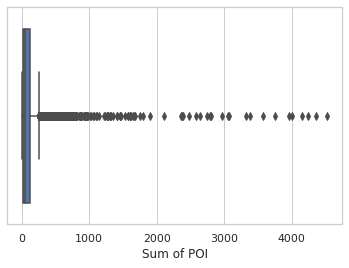

In [ ]:
sns.set_theme(style="whitegrid")

ax = sns.boxplot(x=count["sum"])
ax. set(xlabel= 'Sum of POI', ylabel=None)

In [ ]:
count['diversity'] = np.count_nonzero(count, axis=1)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [ ]:
os.chdir("/content/gdrive/My Drive/big data and city 3")
health = pd.read_csv('US_heal.csv',header=None)

health = np.array(health, dtype=float)
health = pd.DataFrame(health)
health

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
0,1.645791e+06,3646.0,5.9,21.9,18.3,27.3,74.4,7.7,8.3,5.4,69.7,85.2,75.3,4.7,39.3,36.9,10.9,76.4,8.5,32.4,2.6,14.7,79.4,9.1,19.2,84.3,9.6,31.1,2.5,6.9
1,2.132769e+06,4107.0,8.5,18.0,17.7,25.3,71.0,5.2,8.5,4.5,66.1,77.2,67.9,4.5,33.4,32.8,13.6,67.6,9.3,31.2,2.5,18.1,78.9,10.8,19.7,81.1,10.1,35.6,2.3,8.7
2,3.131895e+06,4896.0,8.3,21.4,15.8,29.6,75.0,6.5,8.7,5.8,68.7,79.5,70.0,5.3,34.4,33.5,13.0,68.1,10.6,34.5,2.8,18.9,78.1,10.3,19.5,80.6,10.9,34.4,2.8,9.6
3,9.345803e+05,4722.0,12.3,17.5,14.8,27.0,69.6,4.2,9.6,4.6,64.6,68.3,60.0,5.2,27.1,26.9,16.8,55.5,10.7,31.5,2.8,23.4,78.0,13.5,21.8,79.2,12.1,39.3,2.8,14.8
4,1.623464e+06,4866.0,7.3,17.9,18.3,25.0,71.3,5.6,8.3,4.4,66.9,79.4,72.1,4.2,36.5,35.8,12.2,71.7,8.4,30.8,2.3,15.9,79.0,9.8,19.0,82.1,9.2,34.1,2.1,7.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12583,4.834685e+06,2393.0,25.4,28.2,14.7,38.5,77.9,5.9,10.3,8.2,70.7,68.8,54.3,9.4,25.7,27.3,26.8,48.7,15.7,43.1,3.7,37.2,75.2,16.3,35.9,79.7,17.2,41.3,4.4,20.7
12584,4.827368e+07,7551.0,28.5,19.2,21.2,32.4,69.3,4.0,8.5,5.4,67.5,67.7,56.5,6.1,28.0,32.1,27.2,51.3,11.7,35.7,2.5,31.2,74.6,13.6,35.5,78.7,13.0,43.3,2.8,16.2
12585,1.323610e+07,6406.0,17.5,23.6,16.9,33.3,77.1,5.5,9.3,5.9,72.1,74.2,63.5,6.2,29.5,32.1,20.2,60.6,12.5,37.0,2.9,27.3,79.0,12.8,32.2,82.3,12.2,39.3,3.2,12.4
12586,8.107497e+05,1375.0,17.0,8.7,26.1,14.6,43.2,2.0,8.9,1.3,63.3,64.0,55.4,2.8,31.3,NaN,21.7,64.6,3.1,19.1,1.2,18.6,77.5,13.4,27.0,83.4,7.0,40.2,0.8,7.3


In [ ]:
name = ['area','Population2010','ACCESS2_CrudePrev','ARTHRITIS_CrudePrev','BINGE_CrudePrev','BPHIGH_CrudePrev','BPMED_CrudePrev','CANCER_CrudePrev','CASTHMA_CrudePrev', 'CHD_CrudePrev', 'CHECKUP_CrudePrev','CHOLSCREEN_CrudePrev','COLON_SCREEN_CrudePrev','COPD_CrudePrev','COREM_CrudePrev','COREW_CrudePrev','CSMOKING_CrudePrev','DENTAL_CrudePrev','DIABETES_CrudePrev','HIGHCHOL_CrudePrev', 'KIDNEY_CrudePrev', 'LPA_CrudePrev', 'MAMMOUSE_CrudePrev', 'MHLTH_CrudePrev', 'OBESITY_CrudePrev','PAPTEST_CrudePrev','PHLTH_CrudePrev','SLEEP_CrudePrev','STROKE_CrudePrev','TEETHLOST_CrudePrev']

In [ ]:
health.columns = name

In [ ]:
healthdata = health[['area','Population2010','ARTHRITIS_CrudePrev','BPHIGH_CrudePrev','CANCER_CrudePrev','CASTHMA_CrudePrev','CHD_CrudePrev','COPD_CrudePrev','DIABETES_CrudePrev','HIGHCHOL_CrudePrev','KIDNEY_CrudePrev','MHLTH_CrudePrev','OBESITY_CrudePrev','PHLTH_CrudePrev','STROKE_CrudePrev','TEETHLOST_CrudePrev','ACCESS2_CrudePrev','BPMED_CrudePrev','CHECKUP_CrudePrev','CHOLSCREEN_CrudePrev','COLON_SCREEN_CrudePrev','DENTAL_CrudePrev', 'MAMMOUSE_CrudePrev','COREM_CrudePrev','COREW_CrudePrev','PAPTEST_CrudePrev','BINGE_CrudePrev','CSMOKING_CrudePrev','LPA_CrudePrev','SLEEP_CrudePrev']]

[Text(0, 0.5, ''), Text(0.5, 0, 'Before Removal of Outliers')]

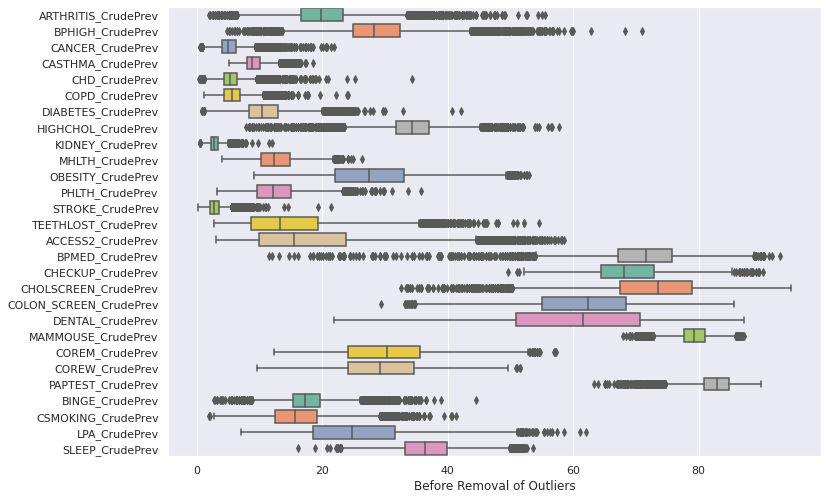

In [ ]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
ax = sns.boxplot(data=healthdata.iloc[:,2:], orient="h", palette="Set2", width = 0.8)
ax. set(xlabel= 'Before Removal of Outliers', ylabel=None)


In [ ]:
from scipy import stats

In [ ]:
#Tukey's method
def tukeys_method(df, variable):
    #Takes two parameters: dataframe & variable of interest as string
    q1 = df[variable].quantile(0.25)
    q3 = df[variable].quantile(0.75)
    iqr = q3-q1
    inner_fence = 1.5*iqr
    outer_fence = 3*iqr
    
    #inner fence lower and upper end
    inner_fence_le = q1-inner_fence
    inner_fence_ue = q3+inner_fence
    
    #outer fence lower and upper end
    outer_fence_le = q1-outer_fence
    outer_fence_ue = q3+outer_fence
    
    outliers_prob = []
    outliers_poss = []
    for index, x in enumerate(df[variable]):
        if x <= outer_fence_le :
            outliers_prob.append(index)
            df[variable][index] = outer_fence_le
        if x >= outer_fence_ue :
            outliers_prob.append(index)
            df[variable][index] = outer_fence_ue
    for index, x in enumerate(df[variable]):
        if x <= inner_fence_le or x >= inner_fence_ue:
            outliers_poss.append(index)
    return outliers_prob, outliers_poss
        


In [ ]:
healthsmooth = ['ARTHRITIS_CrudePrev','BPHIGH_CrudePrev','CANCER_CrudePrev','CASTHMA_CrudePrev','CHD_CrudePrev','COPD_CrudePrev','DIABETES_CrudePrev','HIGHCHOL_CrudePrev','KIDNEY_CrudePrev','MHLTH_CrudePrev','OBESITY_CrudePrev','PHLTH_CrudePrev','STROKE_CrudePrev','TEETHLOST_CrudePrev','ACCESS2_CrudePrev','BPMED_CrudePrev','CHECKUP_CrudePrev','CHOLSCREEN_CrudePrev','COLON_SCREEN_CrudePrev','DENTAL_CrudePrev', 'MAMMOUSE_CrudePrev','COREM_CrudePrev','COREW_CrudePrev','PAPTEST_CrudePrev','BINGE_CrudePrev','CSMOKING_CrudePrev','LPA_CrudePrev','SLEEP_CrudePrev']
for i in healthsmooth:
  outliers_prob, outliers_poss = tukeys_method(healthdata,i)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


[Text(0, 0.5, ''), Text(0.5, 0, 'After Removal of Outliers')]

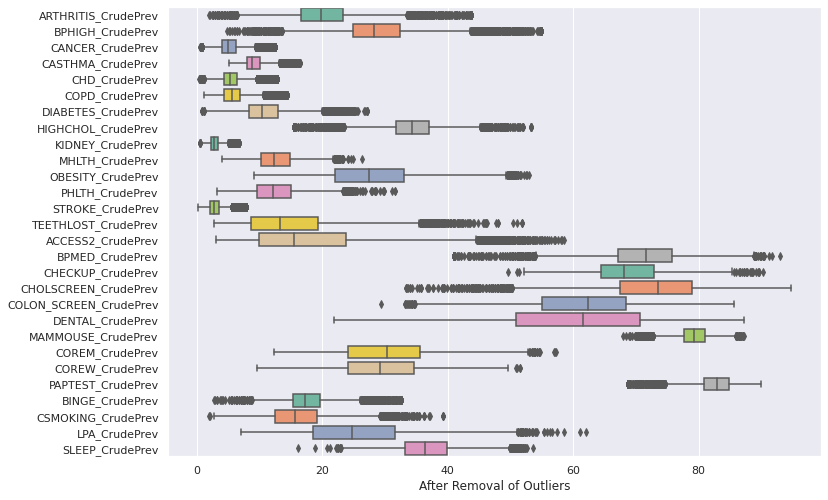

In [ ]:
sns.set(rc={'figure.figsize':(11.7,8.27)})
ax = sns.boxplot(data=healthdata.iloc[:,2:], orient="h", palette="Set2", width = 0.8)
ax. set(xlabel= 'After Removal of Outliers', ylabel=None)

# Data Exploration

In [ ]:
percapita = count.copy()
percapita

,food_bar,food_cafe,food_restaurant,food_fast_food,health_clinic,health_dentist,health_doctors,health_hospital,health_pharmacy,transport_stop_position,transport_platform,transport_station,transport_fuel,transport_parking,transport_bicycle_parking,community_worship,community_police,community_community_centre,community_fire_station,community_post_office,community_post_box,community_waste_basket,community_recycling,leisure_park,leisure_garden,leisure_pitch,leisure_sports_centre,leisure_swimming_pool,tourism_attraction,tourism_artwork,tourism_information,tourism_hotel,tourism_viewpoint,building_apartments,building_commercial,building_industrial,building_retail,building_greenhouse,building_barn,nature_tree,nature_water,nature_wood,nature_peak,nature_sand,nature_coastline,nature_wetland,nature_cliff,shop_clothes,shop_supermarket,shop_bakery,sum,diversity
0,1,2,7,2,0,0,0,0,0,13,16,0,1,15,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,1,3,0,0,0,0,0,0,0,0,0,0,0,2,2,70,15
1,0,2,3,1,1,0,0,0,0,15,13,0,2,38,0,2,0,0,1,1,0,0,0,3,9,10,1,0,0,0,0,0,0,0,1,1,1,0,0,183,0,0,0,1,2,1,0,0,0,0,292,23
2,1,1,5,0,0,0,0,0,2,23,20,0,2,16,0,1,0,0,0,1,0,0,0,3,1,9,0,3,0,2,0,4,0,2,38,0,0,0,0,1,1,0,0,0,0,0,0,0,2,0,138,22
3,0,0,6,0,0,0,0,0,0,13,9,0,0,2,0,0,0,1,1,0,0,0,0,1,0,1,0,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,43,10
4,1,0,1,0,0,0,0,0,0,0,8,0,0,8,0,2,0,0,0,1,0,0,0,1,0,3,0,29,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,56,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12581,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,4,0,0,0,0,0,0,0,4,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,4,0,0,0,0,0,0,0,0,0,16,8
12583,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,5,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,17,6
12584,0,0,1,0,0,1,0,0,0,0,0,0,4,3,0,3,0,0,1,0,0,0,0,2,0,7,0,0,0,0,0,2,0,0,0,2,0,0,0,0,10,0,0,0,0,1,0,0,1,0,38,14
12585,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4,0,1,1,0,0,0,0,3,0,0,1,0,0,0,0,0,0,13,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,27,11


In [ ]:
i = 0
while i < len(percapita.columns):
  percapita.iloc[:,i] = count.iloc[:,i] / healthdata['Population2010']
  i += 1

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
scaler.fit(percapita)
percapita_scaled = scaler.transform(percapita)

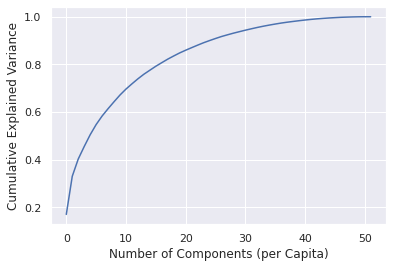

In [ ]:
pca = PCA().fit(percapita_scaled)
sns.set(rc={'figure.figsize':(6,4)})
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components (per Capita)')
plt.ylabel('Cumulative Explained Variance');

In [ ]:
pca.components_ [0]

array([0.22563415, 0.18250223, 0.2000016 , 0.14195978, 0.02959806,
       0.11940533, 0.03427799, 0.0605921 , 0.18238657, 0.13712623,
       0.21447334, 0.18420028, 0.14528379, 0.17203278, 0.24493517,
       0.06804663, 0.07986691, 0.08439697, 0.04061597, 0.12842527,
       0.07990171, 0.05682742, 0.04111554, 0.24996762, 0.12336699,
       0.11516058, 0.15826063, 0.02446041, 0.07606459, 0.14842034,
       0.06622802, 0.25346414, 0.0605063 , 0.08255123, 0.0795775 ,
       0.03575782, 0.10323219, 0.00218533, 0.00615942, 0.08662655,
       0.08499813, 0.0870937 , 0.02085233, 0.05557905, 0.05633476,
       0.04980801, 0.01799354, 0.13276915, 0.14096012, 0.10182231,
       0.23279284, 0.41190076])

In [ ]:
column_name = np.argsort(pca.components_ [0])

In [ ]:
column_name

array([37, 38, 46, 42, 27,  4,  6, 35, 18, 22, 45, 43, 44, 21, 32,  7, 30,
       15, 28, 34, 16, 20, 33, 17, 40, 39, 41, 49, 36, 25,  5, 24, 19, 47,
        9, 48,  3, 12, 29, 26, 13,  8,  1, 11,  2, 10,  0, 50, 14, 23, 31,
       51])

In [ ]:
PCA_importance = percapita.iloc[:,column_name[-20:]]

In [ ]:
list(reversed(PCA_importance.columns.tolist()))

['diversity',
 'tourism_hotel',
 'leisure_park',
 'transport_bicycle_parking',
 'sum',
 'food_bar',
 'transport_platform',
 'food_restaurant',
 'transport_station',
 'food_cafe',
 'health_pharmacy',
 'transport_parking',
 'leisure_sports_centre',
 'tourism_artwork',
 'transport_fuel',
 'food_fast_food',
 'shop_supermarket',
 'transport_stop_position',
 'shop_clothes',
 'community_post_office']

In [ ]:
density = count.copy()
density

,food_bar,food_cafe,food_restaurant,food_fast_food,health_clinic,health_dentist,health_doctors,health_hospital,health_pharmacy,transport_stop_position,transport_platform,transport_station,transport_fuel,transport_parking,transport_bicycle_parking,community_worship,community_police,community_community_centre,community_fire_station,community_post_office,community_post_box,community_waste_basket,community_recycling,leisure_park,leisure_garden,leisure_pitch,leisure_sports_centre,leisure_swimming_pool,tourism_attraction,tourism_artwork,tourism_information,tourism_hotel,tourism_viewpoint,building_apartments,building_commercial,building_industrial,building_retail,building_greenhouse,building_barn,nature_tree,nature_water,nature_wood,nature_peak,nature_sand,nature_coastline,nature_wetland,nature_cliff,shop_clothes,shop_supermarket,shop_bakery,sum,diversity
0,1,2,7,2,0,0,0,0,0,13,16,0,1,15,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,1,3,0,0,0,0,0,0,0,0,0,0,0,2,2,70,15
1,0,2,3,1,1,0,0,0,0,15,13,0,2,38,0,2,0,0,1,1,0,0,0,3,9,10,1,0,0,0,0,0,0,0,1,1,1,0,0,183,0,0,0,1,2,1,0,0,0,0,292,23
2,1,1,5,0,0,0,0,0,2,23,20,0,2,16,0,1,0,0,0,1,0,0,0,3,1,9,0,3,0,2,0,4,0,2,38,0,0,0,0,1,1,0,0,0,0,0,0,0,2,0,138,22
3,0,0,6,0,0,0,0,0,0,13,9,0,0,2,0,0,0,1,1,0,0,0,0,1,0,1,0,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,43,10
4,1,0,1,0,0,0,0,0,0,0,8,0,0,8,0,2,0,0,0,1,0,0,0,1,0,3,0,29,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,56,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12581,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,4,0,0,0,0,0,0,0,4,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,4,0,0,0,0,0,0,0,0,0,16,8
12583,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,5,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,17,6
12584,0,0,1,0,0,1,0,0,0,0,0,0,4,3,0,3,0,0,1,0,0,0,0,2,0,7,0,0,0,0,0,2,0,0,0,2,0,0,0,0,10,0,0,0,0,1,0,0,1,0,38,14
12585,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4,0,1,1,0,0,0,0,3,0,0,1,0,0,0,0,0,0,13,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,27,11


In [ ]:
i = 0
while i < len(density.columns):
  density.iloc[:,i] = count.iloc[:,i] / healthdata['area']
  i += 1

In [ ]:
scaler2 = MinMaxScaler()
scaler2.fit(density)
density_scaled = scaler2.transform(density)

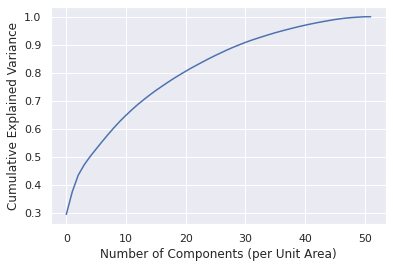

In [ ]:
pca2 = PCA().fit(density_scaled)
plt.plot(np.cumsum(pca2.explained_variance_ratio_))
plt.xlabel('Number of Components (per Unit Area)')
plt.ylabel('Cumulative Explained Variance');

In [ ]:
pca2.components_ [0]

array([ 1.16440931e-01,  2.23442534e-01,  2.54650068e-01,  2.00454300e-01,
        5.45973579e-02,  8.86965962e-02,  3.74893233e-02,  4.07389267e-02,
        2.62338504e-01,  1.91525895e-01,  4.64778470e-01,  1.39315375e-01,
        3.37892336e-02,  7.17189548e-02,  2.69115137e-01,  1.83676559e-01,
        4.11683318e-02,  5.25643227e-02,  8.03193649e-02,  1.38649218e-01,
        1.74548636e-01,  3.15369078e-02,  2.01853600e-02,  1.02829720e-01,
        1.24656527e-02,  3.44007255e-02,  6.10296951e-02, -5.97542127e-04,
        5.15176894e-02,  1.82575209e-02,  1.01930058e-02,  5.11469545e-02,
        1.45887877e-02,  7.84859518e-02,  3.51065909e-02, -3.00960710e-03,
        3.66082968e-02,  4.24857944e-04, -3.06151696e-03,  2.86026933e-02,
        7.41294067e-04, -8.49142580e-04,  1.42002740e-02, -4.71098927e-03,
        4.49096542e-03, -6.25917324e-03,  2.70058736e-03,  7.69641278e-02,
        2.06101976e-01,  1.70236141e-01,  1.81934681e-01,  4.00366659e-01])

In [ ]:
raw = count.copy()
raw

,food_bar,food_cafe,food_restaurant,food_fast_food,health_clinic,health_dentist,health_doctors,health_hospital,health_pharmacy,transport_stop_position,transport_platform,transport_station,transport_fuel,transport_parking,transport_bicycle_parking,community_worship,community_police,community_community_centre,community_fire_station,community_post_office,community_post_box,community_waste_basket,community_recycling,leisure_park,leisure_garden,leisure_pitch,leisure_sports_centre,leisure_swimming_pool,tourism_attraction,tourism_artwork,tourism_information,tourism_hotel,tourism_viewpoint,building_apartments,building_commercial,building_industrial,building_retail,building_greenhouse,building_barn,nature_tree,nature_water,nature_wood,nature_peak,nature_sand,nature_coastline,nature_wetland,nature_cliff,shop_clothes,shop_supermarket,shop_bakery,sum,diversity
0,1,2,7,2,0,0,0,0,0,13,16,0,1,15,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,4,1,3,0,0,0,0,0,0,0,0,0,0,0,2,2,70,15
1,0,2,3,1,1,0,0,0,0,15,13,0,2,38,0,2,0,0,1,1,0,0,0,3,9,10,1,0,0,0,0,0,0,0,1,1,1,0,0,183,0,0,0,1,2,1,0,0,0,0,292,23
2,1,1,5,0,0,0,0,0,2,23,20,0,2,16,0,1,0,0,0,1,0,0,0,3,1,9,0,3,0,2,0,4,0,2,38,0,0,0,0,1,1,0,0,0,0,0,0,0,2,0,138,22
3,0,0,6,0,0,0,0,0,0,13,9,0,0,2,0,0,0,1,1,0,0,0,0,1,0,1,0,9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,43,10
4,1,0,1,0,0,0,0,0,0,0,8,0,0,8,0,2,0,0,0,1,0,0,0,1,0,3,0,29,0,0,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,56,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12581,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,4,0,0,0,0,0,0,0,4,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,4,0,0,0,0,0,0,0,0,0,16,8
12583,0,0,0,0,0,0,0,0,0,0,0,0,4,0,0,5,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,17,6
12584,0,0,1,0,0,1,0,0,0,0,0,0,4,3,0,3,0,0,1,0,0,0,0,2,0,7,0,0,0,0,0,2,0,0,0,2,0,0,0,0,10,0,0,0,0,1,0,0,1,0,38,14
12585,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,4,0,1,1,0,0,0,0,3,0,0,1,0,0,0,0,0,0,13,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,1,27,11


In [ ]:
scaler3 = MinMaxScaler()
scaler3.fit(raw)
raw_scaled = scaler.transform(raw)

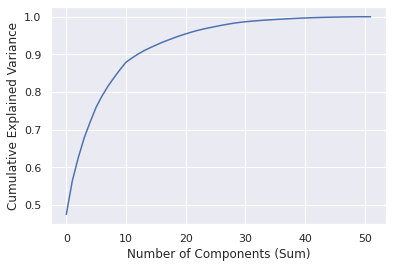

In [ ]:
pca3 = PCA().fit(raw_scaled)
plt.plot(np.cumsum(pca3.explained_variance_ratio_))
plt.xlabel('Number of Components (Sum)')
plt.ylabel('Cumulative Explained Variance');

In [ ]:
pca3.components_ [0]

array([-2.31121843e-03, -3.84441142e-04,  6.10481150e-04, -5.91034722e-04,
       -6.55702243e-04,  8.48528714e-04, -6.72755591e-03, -1.49739453e-03,
       -6.40102547e-03, -6.18022766e-03, -3.21155542e-03, -2.02442611e-03,
       -1.18380396e-03,  1.11635250e-03, -2.28640844e-03, -6.58655469e-03,
       -4.20597997e-03, -3.22640431e-03, -1.50878446e-03, -6.07568633e-04,
       -6.47661730e-03, -4.77332561e-04, -7.49509680e-04, -1.22230387e-02,
       -2.33397506e-03, -1.44105396e-03, -1.87429748e-03,  4.10859920e-03,
       -1.20159428e-04, -1.03504722e-03, -4.81003690e-04,  2.72601998e-03,
       -1.76006161e-03,  9.77687524e-01,  2.79621523e-02,  1.93445564e-03,
        2.03516397e-01,  2.96189945e-03,  7.99788416e-05, -4.32172023e-03,
       -2.79999998e-03, -2.73682861e-03, -1.14741217e-03, -7.23361078e-04,
       -6.61364687e-03, -9.05520932e-04, -1.40300758e-03,  6.27030664e-05,
       -4.90578626e-03, -2.51108541e-03,  3.65408762e-02,  1.85461014e-03])

# Data preparing

From the PCA analysis, we decide to use the percapita data for training. Below are data preparation and separation of training and testing data. 

In [ ]:
alldata = pd.merge(percapita, healthdata, left_index=True, right_index=True)
alldata

,food_bar,food_cafe,food_restaurant,food_fast_food,health_clinic,health_dentist,health_doctors,health_hospital,health_pharmacy,transport_stop_position,transport_platform,transport_station,transport_fuel,transport_parking,transport_bicycle_parking,community_worship,community_police,community_community_centre,community_fire_station,community_post_office,community_post_box,community_waste_basket,community_recycling,leisure_park,leisure_garden,leisure_pitch,leisure_sports_centre,leisure_swimming_pool,tourism_attraction,tourism_artwork,tourism_information,tourism_hotel,tourism_viewpoint,building_apartments,building_commercial,building_industrial,building_retail,building_greenhouse,building_barn,nature_tree,...,nature_peak,nature_sand,nature_coastline,nature_wetland,nature_cliff,shop_clothes,shop_supermarket,shop_bakery,sum,diversity,area,Population2010,ARTHRITIS_CrudePrev,BPHIGH_CrudePrev,CANCER_CrudePrev,CASTHMA_CrudePrev,CHD_CrudePrev,COPD_CrudePrev,DIABETES_CrudePrev,HIGHCHOL_CrudePrev,KIDNEY_CrudePrev,MHLTH_CrudePrev,OBESITY_CrudePrev,PHLTH_CrudePrev,STROKE_CrudePrev,TEETHLOST_CrudePrev,ACCESS2_CrudePrev,BPMED_CrudePrev,CHECKUP_CrudePrev,CHOLSCREEN_CrudePrev,COLON_SCREEN_CrudePrev,DENTAL_CrudePrev,MAMMOUSE_CrudePrev,COREM_CrudePrev,COREW_CrudePrev,PAPTEST_CrudePrev,BINGE_CrudePrev,CSMOKING_CrudePrev,LPA_CrudePrev,SLEEP_CrudePrev
0,0.000274,0.000549,0.001920,0.000549,0.000000,0.000000,0.0,0.000000,0.000000,0.003566,0.004388,0.0,0.000274,0.004114,0.0,0.000000,0.0,0.000000,0.000000,0.000274,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.001097,0.000274,0.000823,0.0,0.0,0.000000,...,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000549,0.000549,0.019199,0.004114,1.645791e+06,3646.0,21.9,27.3,7.7,8.3,5.4,4.7,8.5,32.4,2.6,9.1,19.2,9.6,2.5,6.9,5.9,74.4,69.7,85.2,75.3,76.4,79.4,39.3,36.9,84.3,18.3,10.9,14.7,31.1
1,0.000000,0.000487,0.000730,0.000243,0.000243,0.000000,0.0,0.000000,0.000000,0.003652,0.003165,0.0,0.000487,0.009252,0.0,0.000487,0.0,0.000000,0.000243,0.000243,0.0,0.0,0.0,0.000730,0.002191,0.002435,0.000243,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000243,0.000243,0.000243,0.0,0.0,0.044558,...,0.0,0.000243,0.000487,0.000243,0.0,0.0,0.000000,0.000000,0.071098,0.005600,2.132769e+06,4107.0,18.0,25.3,5.2,8.5,4.5,4.5,9.3,31.2,2.5,10.8,19.7,10.1,2.3,8.7,8.5,71.0,66.1,77.2,67.9,67.6,78.9,33.4,32.8,81.1,17.7,13.6,18.1,35.6
2,0.000204,0.000204,0.001021,0.000000,0.000000,0.000000,0.0,0.000000,0.000408,0.004698,0.004085,0.0,0.000408,0.003268,0.0,0.000204,0.0,0.000000,0.000000,0.000204,0.0,0.0,0.0,0.000613,0.000204,0.001838,0.000000,0.000613,0.0,0.000408,0.000000,0.000817,0.0,0.000408,0.007761,0.000000,0.000000,0.0,0.0,0.000204,...,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000408,0.000000,0.028186,0.004493,3.131895e+06,4896.0,21.4,29.6,6.5,8.7,5.8,5.3,10.6,34.5,2.8,10.3,19.5,10.9,2.8,9.6,8.3,75.0,68.7,79.5,70.0,68.1,78.1,34.4,33.5,80.6,15.8,13.0,18.9,34.4
3,0.000000,0.000000,0.001271,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.002753,0.001906,0.0,0.000000,0.000424,0.0,0.000000,0.0,0.000212,0.000212,0.000000,0.0,0.0,0.0,0.000212,0.000000,0.000212,0.000000,0.001906,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,...,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.009106,0.002118,9.345803e+05,4722.0,17.5,27.0,4.2,9.6,4.6,5.2,10.7,31.5,2.8,13.5,21.8,12.1,2.8,14.8,12.3,69.6,64.6,68.3,60.0,55.5,78.0,27.1,26.9,79.2,14.8,16.8,23.4,39.3
4,0.000206,0.000000,0.000206,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.001644,0.0,0.000000,0.001644,0.0,0.000411,0.0,0.000000,0.000000,0.000206,0.0,0.0,0.0,0.000206,0.000000,0.000617,0.000000,0.005960,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000411,0.000000,0.000000,0.0,0.0,0.000000,...,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.011508,0.002261,1.623464e+06,4866.0,17.9,25.0,5.6,8.3,4.4,4.2,8.4,30.8,2.3,9.8,19.0,9.2,2.1,7.5,7.3,71.3,66.9,79.4,72.1,71.7,79.0,

In [ ]:
alldata.isnull().sum()

food_bar              0
food_cafe             0
food_restaurant       0
food_fast_food        0
health_clinic         0
                     ..
PAPTEST_CrudePrev     1
BINGE_CrudePrev       0
CSMOKING_CrudePrev    0
LPA_CrudePrev         0
SLEEP_CrudePrev       0
Length: 82, dtype: int64

In [ ]:
from sklearn import model_selection
X = alldata.iloc[:,:54].copy().fillna(alldata.mean())
y = alldata.iloc[:,54:].copy().fillna(alldata.mean())
X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y, test_size=0.25, random_state=42)

In [ ]:
print('training data has ' + str(X_train.shape[0]) + ' observation with ' + str(X_train.shape[1]) + ' features')
print('test data has ' + str(X_test.shape[0]) + ' observation with ' + str(X_test.shape[1]) + ' features')

training data has 7248 observation with 54 features
test data has 2417 observation with 54 features


In [ ]:
X_train = pd.DataFrame(X_train)
X_test = pd.DataFrame(X_test)
y_train = pd.DataFrame(y_train)
y_test = pd.DataFrame(y_test)

In [ ]:
y_test

,ARTHRITIS_CrudePrev,BPHIGH_CrudePrev,CANCER_CrudePrev,CASTHMA_CrudePrev,CHD_CrudePrev,COPD_CrudePrev,DIABETES_CrudePrev,HIGHCHOL_CrudePrev,KIDNEY_CrudePrev,MHLTH_CrudePrev,OBESITY_CrudePrev,PHLTH_CrudePrev,STROKE_CrudePrev,TEETHLOST_CrudePrev,ACCESS2_CrudePrev,BPMED_CrudePrev,CHECKUP_CrudePrev,CHOLSCREEN_CrudePrev,COLON_SCREEN_CrudePrev,DENTAL_CrudePrev,MAMMOUSE_CrudePrev,COREM_CrudePrev,COREW_CrudePrev,PAPTEST_CrudePrev,BINGE_CrudePrev,CSMOKING_CrudePrev,LPA_CrudePrev,SLEEP_CrudePrev
8878,27.3,36.6,4.6,15.3,7.6,11.4,15.5,37.5,3.9,21.7,41.3,21.4,5.0,33.700000,21.2,71.2,72.3,64.3,51.7,39.7,76.6,24.300000,17.900000,83.0,14.6,33.3,40.4,48.8
8949,30.0,32.4,8.2,10.1,8.4,7.6,12.1,40.1,3.7,10.9,24.3,14.1,4.1,17.600000,14.6,79.0,74.2,81.2,63.3,63.8,78.0,33.900000,27.400000,83.4,14.1,13.2,31.2,33.8
8760,23.8,27.6,6.3,9.6,5.4,5.5,9.0,35.2,2.3,11.3,27.5,11.0,2.3,10.800000,10.1,73.1,72.7,79.3,64.7,69.1,76.3,35.900000,28.700000,84.2,20.1,16.6,25.4,42.2
1717,15.6,25.1,4.4,7.6,4.4,4.3,9.8,33.1,2.5,11.3,22.7,11.3,2.2,10.000000,17.3,67.3,64.8,72.9,59.4,61.6,77.3,26.400000,33.300000,82.2,16.6,12.0,21.7,36.7
49,17.0,23.8,5.8,7.9,4.1,4.2,7.7,32.1,2.2,9.6,19.8,9.3,2.0,6.700000,6.8,69.3,66.9,80.2,71.3,74.9,80.0,43.200000,37.000000,83.6,18.1,11.1,14.0,31.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11148,4.1,10.9,0.8,9.5,0.9,2.4,2.1,15.5,1.0,15.9,22.2,6.4,0.5,14.270242,22.7,41.0,62.1,39.1,46.4,53.4,76.1,30.500571,29.890923,70.6,20.4,14.6,20.7,35.6
10679,18.8,28.1,4.4,7.8,5.0,4.3,12.6,34.3,2.9,11.5,33.2,12.7,2.5,10.200000,28.5,73.6,67.5,71.2,55.8,58.1,81.4,28.100000,26.900000,82.5,18.6,14.0,25.4,36.1
12414,15.0,20.9,3.5,8.2,3.3,3.8,7.7,29.5,2.1,12.0,33.2,10.2,1.7,10.500000,22.2,66.4,65.9,69.1,61.0,61.0,78.6,34.500000,33.800000,82.3,21.0,15.3,22.8,35.2
11211,29.9,50.2,6.4,11.3,9.0,8.8,21.8,44.6,4.8,14.2,42.9,17.3,6.5,27.000000,27.9,83.4,78.0,73.0,58.6,45.1,80.1,20.200000,23.600000,82.5,11.3,20.1,38.0,42.3


# Model training

First Round of model training

In [ ]:
data = X_train.iloc[:,:].values.tolist()
data2 = y_train.iloc[:,:].values.tolist()

test = X_test.iloc[:,:].values.tolist()
test2 = y_test.iloc[:,:].values.tolist()

maxi = [-math.inf for i in range(len(data[0]))]
mini = [math.inf for i in range(len(data[0]))]

for i in range(len(data)):
    for j in range(len(data[i])):
        if data[i][j]>maxi[j]:
            maxi[j] = data[i][j]
        if data[i][j]<mini[j]:
            mini[j] = data[i][j]


for i in range(len(data)):
    for j in range(len(data[i])):
        data[i][j] = (data[i][j]-mini[j])/(maxi[j]-mini[j])


for i in range(len(test)):
    for j in range(len(test[i])):
        test[i][j] = (test[i][j]-mini[j])/(maxi[j]-mini[j])

maxi = [-math.inf for i in range(len(data2[0]))]
mini = [math.inf for i in range(len(data2[0]))]


for i in range(len(data2)):
    for j in range(len(data2[i])):
        if data2[i][j]>maxi[j]:
            maxi[j] = data2[i][j]
        if data2[i][j]<mini[j]:
            mini[j] = data2[i][j]


for i in range(len(data2)):
    for j in range(len(data2[i])):
        data2[i][j] = (data2[i][j]-mini[j])/(maxi[j]-mini[j])


for i in range(len(test2)):
    for j in range(len(test2[i])):
        test2[i][j] = (test2[i][j]-mini[j])/(maxi[j]-mini[j])        


In [ ]:
import tensorflow.compat.v1 as tf
tf.disable_eager_execution()

def initialize():
    #placeholder
    x = tf.placeholder(tf.float32, [None, D_in])
    y = tf.placeholder(tf.float32, [None, D_out])
    w = {
        'h1': tf.Variable(tf.random_normal([D_in, D_h1])),
        'h2': tf.Variable(tf.random_normal([D_h1, D_h2])),
        'h3': tf.Variable(tf.random_normal([D_h2, D_h3])),
        'h4': tf.Variable(tf.random_normal([D_h3, D_h4])),
        'h5': tf.Variable(tf.random_normal([D_h4, D_h5])),
        #'h6': tf.Variable(tf.random_normal([D_h5, D_h6])),
        #'h7': tf.Variable(tf.random_normal([D_h6, D_h7])),
        #'h8': tf.Variable(tf.random_normal([D_h7, D_h8])),
        #'h9': tf.Variable(tf.random_normal([D_h8, D_h9])),
        #'h10': tf.Variable(tf.random_normal([D_h9, D_h10])),
        'out': tf.Variable(tf.random_normal([D_h5, D_out]))
    }
    b = {
        'h1': tf.Variable(tf.random_normal([D_h1])),
        'h2': tf.Variable(tf.random_normal([D_h2])),
        'h3': tf.Variable(tf.random_normal([D_h3])),
        'h4': tf.Variable(tf.random_normal([D_h4])),
        'h5': tf.Variable(tf.random_normal([D_h5])),
        #'h6': tf.Variable(tf.random_normal([D_h6])),
        #'h7': tf.Variable(tf.random_normal([D_h7])),
        #'h8': tf.Variable(tf.random_normal([D_h8])),
        #'h9': tf.Variable(tf.random_normal([D_h9])),
        #'h10': tf.Variable(tf.random_normal([D_h10])),
        'out': tf.Variable(tf.random_normal([D_out]))
    }

    #activation functions #tf.layers.batch_normalization()
    def multilayer_perceptron(x):
        h1_layer = tf.sigmoid(tf.add(tf.matmul(x, w['h1']), b['h1']))
        h2_layer = tf.sigmoid(tf.add(tf.matmul(h1_layer, w['h2']), b['h2']))
        h3_layer = tf.sigmoid(tf.add(tf.matmul(h2_layer, w['h3']), b['h3']))
        h4_layer = tf.sigmoid(tf.add(tf.matmul(h3_layer, w['h4']), b['h4']))
        h5_layer = tf.sigmoid(tf.add(tf.matmul(h4_layer, w['h5']), b['h5']))
        #h6_layer = tf.sigmoid(tf.add(tf.matmul(h5_layer, w['h6']), b['h6']))
        #h7_layer = tf.sigmoid(tf.add(tf.matmul(h6_layer, w['h7']), b['h7']))
        #h8_layer = tf.sigmoid(tf.add(tf.matmul(h7_layer, w['h8']), b['h8']))
        #h9_layer = tf.sigmoid(tf.add(tf.matmul(h8_layer, w['h9']), b['h9']))
        #h10_layer = tf.sigmoid(tf.add(tf.matmul(h9_layer, w['h10']), b['h10']))
        out_layer = tf.sigmoid(tf.add(tf.matmul(h5_layer, w['out']), b['out']))
        return out_layer
    pred = multilayer_perceptron(x)

    #loss function
    #cost = tf.reduce_sum(tf.where(tf.greater(pred, 0.932), 10*(y-pred)*(y-pred),
    #                     tf.where(tf.greater(0.042, pred), 10*(y-pred)*(y-pred),
    #                     (y-pred)*(y-pred))))
    cost = tf.reduce_sum((y-pred)*(y-pred))

    #optimizer and others
    optimizer = tf.train.AdamOptimizer(0.001).minimize(cost)
    init = tf.global_variables_initializer()
    variables_dict = {
        'b1': b['h1'],
        'b2': b['h2'],
        'b3': b['h3'],
        'b4': b['h4'],
        'b5': b['h5'],
        #'b6': b['h6'],
        #'b7': b['h7'],
        #'b8': b['h8'],
        #'b9': b['h9'],
        #'b10': b['h10'],
        'bout': b['out'],
        'w1': w['h1'],
        'w2': w['h2'],
        'w3': w['h3'],
        'w4': w['h4'],
        'w5': w['h5'],
        #'w6': w['h6'],
        #'w7': w['h7'],
        #'w8': w['h8'],
        #'w9': w['h9'],
        #'w10': w['h10'],
        'wout': w['out']
    }
    saver = tf.train.Saver(variables_dict)
    saver = tf.train.Saver(max_to_keep=1000, keep_checkpoint_every_n_hours=1)
    return x, y, pred, cost, optimizer, init, saver


def evaluate(filename, dimensionx):
    xdata = []
    with open(filename) as f:
        lines = f.readlines()
    temp = []
    for line in lines:
        temp.append(float(line))
        if len(temp)==dimensionx:
            xdata.append(temp)
            temp = []
    
    with tf.Session() as sess:
        saver.restore(sess, "./model.ckpt")
        yhat = pred.eval(feed_dict = {x: xdata})
        
        
def evaluatewhentrain(X_test, modelfile):
    with tf.Session() as sess:
        saver.restore(sess, modelfile)
        yhat = pred.eval(feed_dict = {x: X_test})
    return yhat


def train(X_test, Y_test):
    with tf.Session() as sess:
        sess.run(init)
        merged_all = tf.summary.merge_all()
        writer = tf.summary.FileWriter('logs/', sess.graph)
        for epoch in range(training_epochs):
            avg_cost = 0.
            total_batch = int(num/batch_size)
            if num%batch_size != 0:
                total_batch = total_batch + 1
            for i in range(total_batch):
                batch_xs = xdata[i*batch_size:(i+1)*batch_size]
                batch_ys = ydata[i*batch_size:(i+1)*batch_size]
                _, c = sess.run([optimizer, cost], feed_dict={x: batch_xs, y: batch_ys})
                avg_cost += c / total_batch
            if (epoch+1) % display_step == 0 or epoch == 0:
                print("Epoch:", '%04d' % (epoch+1), " cost=", "{:.9f}".format(avg_cost))
                #merged = sess.run(merged_all, feed_dict={x: batch_xs, y: batch_ys})
                #writer.add_summary(merged, epoch)
            if (epoch+1) % save_step == 0:
                saver.save(sess, "./model"+str(epoch)+".ckpt")
                print("save model done.")
                yhat = np.array(evaluatewhentrain(X_test,"./model"+str(epoch)+".ckpt"))
                accuracy = 100 - np.around(np.median(np.abs(yhat-Y_test)*100,axis=0),decimals=1)
                
                print('5-layer ANN', accuracy, '% Step '+str(epoch))

In [ ]:
#training settings
training_epochs = 200000
save_step = 1000

batch_size = 100
display_step = 1000

#network structure
D_in, D_out = 54, 28
D_h1 = 54
D_h2 = 54
D_h3 = 54
D_h4 = 54
D_h5 = 54
#D_h6 = 32
#D_h7 = 32
#D_h8 = 32
#D_h9 = 32
#D_h10 = 32

#initialize
x, y, pred, cost, optimizer, init, saver = initialize()


#load data
xdata = np.array(data)
ydata = np.array(data2)
X_test = np.array(test)
Y_test = np.array(test2)

num = len(xdata)
print(xdata)
print(ydata)

[[0.         0.         0.         ... 0.0121019  0.00293718 0.0811138 ]
 [0.         0.00318627 0.00119485 ... 0.0173749  0.0067825  0.13939813]
 [0.00906649 0.00436535 0.00654802 ... 0.01217265 0.00050225 0.10127983]
 ...
 [0.         0.01267674 0.00475378 ... 0.02215676 0.00310654 0.0692148 ]
 [0.         0.         0.         ... 0.00464158 0.00454444 0.20895884]
 [0.         0.         0.         ... 0.01411313 0.00124341 0.0702871 ]]
[[0.68990385 0.662      0.33898305 ... 0.78552279 0.61320755 0.95266272]
 [0.26442308 0.292      0.30508475 ... 0.24664879 0.10188679 0.26035503]
 [0.24519231 0.302      0.3220339  ... 0.32707775 0.32641509 0.3816568 ]
 ...
 [0.54567308 0.584      0.33050847 ... 0.61126005 0.43018868 0.71597633]
 [0.32692308 0.384      0.28813559 ... 0.36193029 0.25660377 0.53550296]
 [0.36538462 0.28       0.33050847 ... 0.25201072 0.0754717  0.42899408]]


In [ ]:
train(X_test, Y_test)

Epoch: 0001  cost= 304.883145267
Epoch: 1000  cost= 39.177232089
save model done.
INFO:tensorflow:Restoring parameters from ./model999.ckpt
5-layer ANN [93.9 94.  92.9 92.7 93.  92.4 93.9 93.9 93.7 92.6 92.  93.4 92.8 92.7
 91.3 93.7 92.6 92.8 90.8 90.4 91.8 91.7 91.2 92.3 94.3 93.3 91.7 92.5] % Step 999
Epoch: 2000  cost= 33.536459361
save model done.
INFO:tensorflow:Restoring parameters from ./model1999.ckpt
5-layer ANN [94.5 94.6 93.4 93.1 93.5 93.5 94.3 94.1 94.6 93.3 92.8 94.3 93.8 93.4
 92.2 93.9 93.3 93.1 91.7 91.1 92.5 92.3 91.9 92.3 94.4 93.6 92.7 92.9] % Step 1999
Epoch: 3000  cost= 29.136964968
save model done.
INFO:tensorflow:Restoring parameters from ./model2999.ckpt
5-layer ANN [94.6 94.6 93.5 93.6 93.9 94.2 94.7 94.2 94.7 93.9 93.2 94.7 93.9 94.1
 92.7 94.  93.5 93.1 92.3 91.9 92.8 92.4 92.6 92.6 94.6 94.4 93.4 93.3] % Step 2999
Epoch: 4000  cost= 24.701189159
save model done.
INFO:tensorflow:Restoring parameters from ./model3999.ckpt
5-layer ANN [94.9 94.9 94.  93.9 94.

KeyboardInterrupt: ignored

In [ ]:
import warnings
warnings.filterwarnings("ignore")
import datetime
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
import sys
import random
%matplotlib inline

X_input = np.array(data)
Y_input = np.array(data2)

X_output = np.array(test)
Y_output = np.array(test2)

# import xgboost as xgb
from sklearn.model_selection import train_test_split


# Different types of regressors
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.preprocessing import PolynomialFeatures
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.dummy import DummyClassifier
from sklearn.metrics import mean_absolute_error
from sklearn.neighbors import KNeighborsRegressor

def my_custom_loss_func(ground_truth, predictions):
    return np.average(np.around(np.median(100*np.abs(predictions-ground_truth),axis=0),decimals=1))

#outtemp = []
#exdata, exdatastr = exeva(0,[],'',10)

regr = DummyClassifier(strategy="uniform")
regr.fit(X_input,Y_input)
#outtemp.append(findDT(regr,exdata,exdatastr))
#evadata('data/nne.txt', D_in, regr)
preds = regr.predict(X_output)
print(mean_absolute_error(Y_output, preds))

print ('Median Accuracy for RandomPrediction', 100-my_custom_loss_func(Y_output,preds),'%')

regr = LinearRegression()
regr.fit(X_input,Y_input)
preds = regr.predict(X_output)
print(mean_absolute_error(Y_output, preds))

print ('Median Accuracy for LinearRegressor', 100-my_custom_loss_func(Y_output,preds),'%')

n_estimators = 300
regr = DecisionTreeRegressor()
regr.fit(X_input,Y_input)
#outtemp.append(findDT(regr,exdata,exdatastr))
#evadata('data/nne.txt', D_in, regr)
preds = regr.predict(X_output)
print(mean_absolute_error(Y_output, preds))
print(regr.score(X_output, Y_output))
print ('Median Accuracy for DecisionTreeRegressor',100-my_custom_loss_func(Y_output,preds),'%')

regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=None,min_samples_split=2, random_state=0,n_jobs=-1)
regr.fit(X_input,Y_input)
#outtemp.append(findDT(regr,exdata,exdatastr))
#evadata('data/nne.txt', D_in, regr)
preds = regr.predict(X_output)
print(mean_absolute_error(Y_output, preds))
print(regr.score(X_output, Y_output))
print ('Median Accuracy for RandomForestRegressor', 100-my_custom_loss_func(Y_output,preds),'%')

regr = KNeighborsRegressor()
regr.fit(X_input,Y_input)
preds = regr.predict(X_output)
print(mean_absolute_error(Y_output, preds))
print(regr.score(X_output, Y_output))
print ('Median Accuracy for KNeighborsRegressor', 100-my_custom_loss_func(Y_output,preds),'%')



0.25670931191683916
Median Accuracy for RandomPrediction 77.19285714285714 %
0.11540988903139393
Median Accuracy for LinearRegressor 90.62142857142857 %
0.13574572951871913
-0.3988524608542163
Median Accuracy for DecisionTreeRegressor 89.42857142857143 %
0.0960775596914245
0.3099459988517086
Median Accuracy for RandomForestRegressor 92.33214285714286 %
0.11294622593946602
0.06961751815078869
Median Accuracy for KNeighborsRegressor 90.85357142857143 %


In [ ]:
X_pre = X_test

with tf.Session() as sess:
    saver.restore(sess, "./model999.ckpt")
    yhat = pred.eval(feed_dict = {x: X_pre})

print(yhat)

INFO:tensorflow:Restoring parameters from ./model999.ckpt
[[0.95087945 0.08534786 0.06251264 ... 0.86271524 0.17969665 0.9990733 ]
 [0.94896245 0.08571371 0.06057853 ... 0.86351407 0.17478502 0.99905086]
 [0.950085   0.08903554 0.06226426 ... 0.8638249  0.17785454 0.9990756 ]
 ...
 [0.939992   0.07744384 0.05743739 ... 0.86118495 0.1716378  0.9989937 ]
 [0.9496795  0.08883607 0.06359389 ... 0.86124396 0.17700717 0.99911094]
 [0.94252133 0.08214739 0.05929977 ... 0.86410296 0.17333958 0.99902856]]


In [ ]:
print(mean_absolute_error(Y_output, yhat))
print ('Median Accuracy for ANN', 100-my_custom_loss_func(Y_test,yhat),'%')

0.3448332853088792
Median Accuracy for ANN 66.53214285714284 %


# Feature Selection

Feature selection based on permutation feature importance of the Random Forest model

In [ ]:
from sklearn.model_selection import ShuffleSplit
from sklearn.metrics import r2_score
from collections import defaultdict
 
X = X_input
Y = Y_input
names = alldata.iloc[:,:54].columns.tolist()
 
rf = RandomForestRegressor()
scores = defaultdict(list)

rs = ShuffleSplit(n_splits=100, test_size=.25, random_state=0)
 
#crossvalidate the scores on a number of different random splits of the data
for train_idx, test_idx in rs.split(X):
    X_train, X_test = X[train_idx], X[test_idx]
    Y_train, Y_test = Y[train_idx], Y[test_idx]
    r = rf.fit(X_train, Y_train)
    acc = r2_score(Y_test, rf.predict(X_test))
    for i in range(X.shape[1]):
        X_t = X_test.copy()
        np.random.shuffle(X_t[:, i])
        shuff_acc = r2_score(Y_test, rf.predict(X_t))
        scores[names[i]].append((acc-shuff_acc)/acc)
print ("Features sorted by their score:")
print (sorted([(round(np.mean(score), 4), feat) for
              feat, score in scores.items()], reverse=True))

Features sorted by their score:
[(0.4872, 'community_worship'), (0.3598, 'area'), (0.2564, 'food_cafe'), (0.1995, 'leisure_swimming_pool'), (0.0912, 'building_apartments'), (0.0763, 'transport_bicycle_parking'), (0.073, 'food_restaurant'), (0.0556, 'transport_platform'), (0.0544, 'Population2010'), (0.0467, 'diversity'), (0.0409, 'nature_water'), (0.0356, 'sum'), (0.0301, 'transport_parking'), (0.0294, 'building_retail'), (0.0279, 'building_industrial'), (0.0277, 'transport_stop_position'), (0.0237, 'building_commercial'), (0.0209, 'transport_fuel'), (0.0203, 'leisure_park'), (0.0181, 'community_post_box'), (0.0175, 'leisure_pitch'), (0.0141, 'community_police'), (0.01, 'nature_wood'), (0.0058, 'transport_station'), (0.0051, 'tourism_hotel'), (0.0049, 'food_bar'), (0.0032, 'food_fast_food'), (0.0028, 'community_community_centre'), (0.0024, 'nature_tree'), (0.0024, 'leisure_garden'), (0.0022, 'tourism_information'), (0.002, 'health_pharmacy'), (0.0014, 'nature_peak'), (0.0014, 'communit

In [ ]:
feature_score = pd.DataFrame(sorted([(round(np.mean(score), 4), feat) for feat, score in scores.items()], reverse=True), columns=['score', 'feature'])

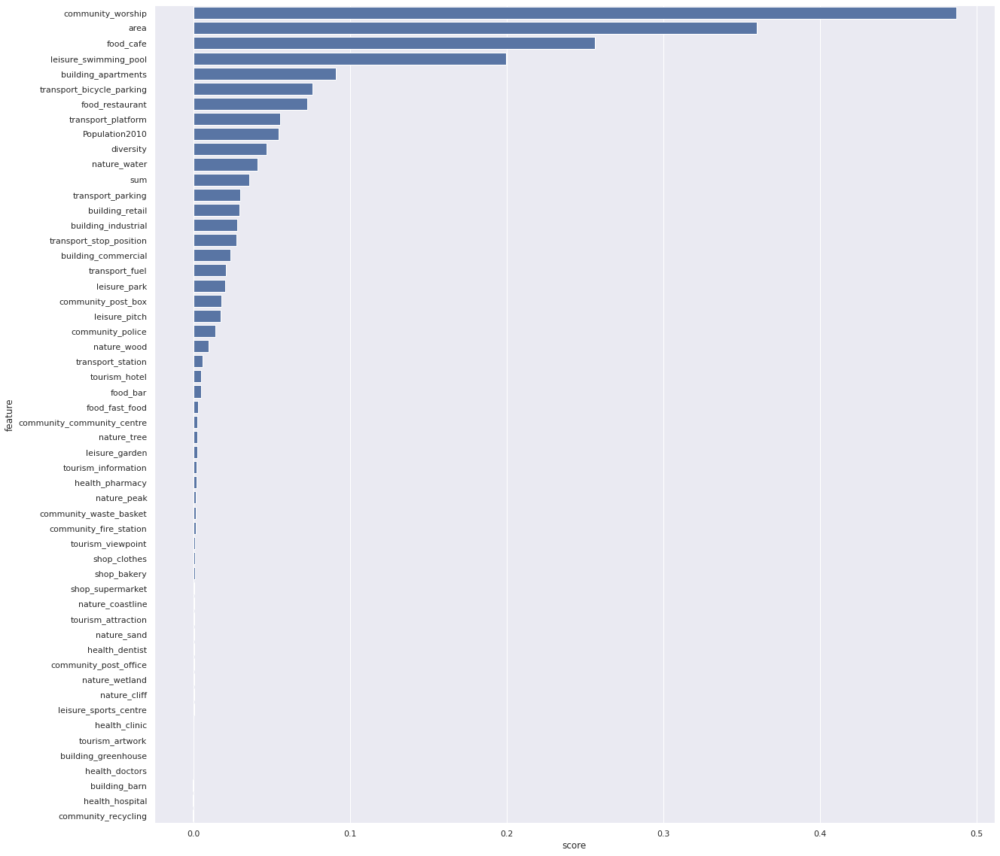

In [ ]:
sns.set(rc={'figure.figsize':(20,20)})
ax = sns.barplot(x="score", y="feature", data=feature_score, label="Total", color='b')

In [ ]:
feature_score = feature_score.sort_values('feature')

In [ ]:
feature_score

,score,feature
8,0.0544,Population2010
1,0.3598,area
4,0.0912,building_apartments
51,-0.0001,building_barn
16,0.0237,building_commercial
49,0.0003,building_greenhouse
14,0.0279,building_industrial
13,0.0294,building_retail
27,0.0028,community_community_centre
34,0.0014,community_fire_station


Export a copy to shorten processing time

In [ ]:
feature_score.to_excel('cumulative.xlsx')

In [ ]:
feature_score = pd.read_excel('cumulative.xlsx')

In [ ]:
category = pd.read_csv('category.csv',header=None)

In [ ]:
category = category.sort_values(1,ascending=False)

In [ ]:
category

,0,1
1,community,0.5185
2,food,0.3419
4,leisure,0.2463
8,transport,0.2199
0,building,0.1706
5,natural,0.0558
7,tourism,0.0096
3,health,0.0045
6,shop,0.0034


In [ ]:
category.at[5,0] = 'nature'

In [ ]:
category

,0,1
1,community,0.5185
2,food,0.3419
4,leisure,0.2463
8,transport,0.2199
0,building,0.1706
5,nature,0.0558
7,tourism,0.0096
3,health,0.0045
6,shop,0.0034


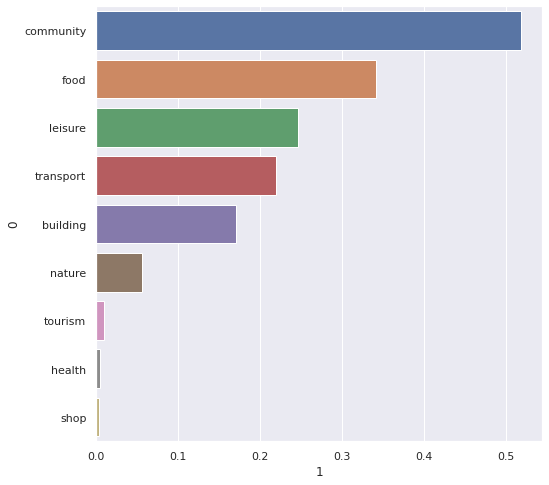

In [ ]:
sns.set(rc={'figure.figsize':(8,8)})
ax = sns.barplot(x=1, y=0, data=category)

In [ ]:
feature_score = feature_score.sort_values('score', ascending=False)

In [ ]:
selectedfeature = feature_score.loc[(feature_score['score'] >= 0.005)]


In [ ]:
selectedfeature

,score,feature
0,0.4872,community_worship
1,0.3598,area
2,0.2564,food_cafe
3,0.1995,leisure_swimming_pool
4,0.0912,building_apartments
5,0.0763,transport_bicycle_parking
6,0.0730,food_restaurant
7,0.0556,transport_platform
8,0.0544,Population2010
9,0.0467,diversity


In [ ]:
X2 = alldata[selectedfeature['feature']].copy().fillna(alldata.mean())
y2 = alldata.iloc[:,54:].copy().fillna(alldata.mean())
X_train2, X_test2, y_train2, y_test2 = model_selection.train_test_split(X2, y2, test_size=0.25, random_state=42)

In [ ]:
Selected_alldata = X2.merge(y2,left_index = True, right_index = True)

In [ ]:
corr_score3 = Selected_alldata.corr()

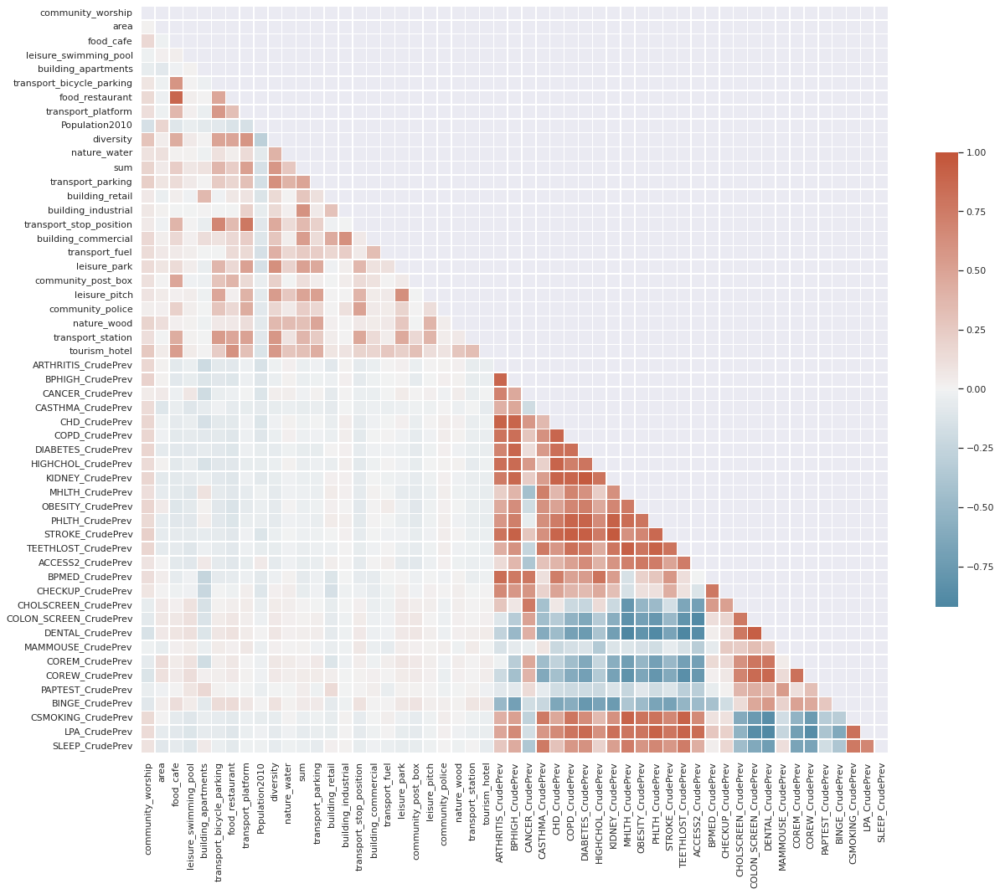

In [ ]:
mask = np.triu(np.ones_like(corr_score3, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr_score3, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [ ]:
print('training data has ' + str(X_train2.shape[0]) + ' observation with ' + str(X_train2.shape[1]) + ' features')
print('test data has ' + str(X_test2.shape[0]) + ' observation with ' + str(X_test2.shape[1]) + ' features')

training data has 7248 observation with 25 features
test data has 2417 observation with 25 features


In [ ]:
X_train2

,community_worship,area,food_cafe,leisure_swimming_pool,building_apartments,transport_bicycle_parking,food_restaurant,transport_platform,Population2010,diversity,nature_water,sum,transport_parking,building_retail,building_industrial,transport_stop_position,building_commercial,transport_fuel,leisure_park,community_post_box,leisure_pitch,community_police,nature_wood,transport_station,tourism_hotel
9057,0.002923,1.134528e+06,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2395.0,0.003340,0.000000,0.005846,0.000000,0.000000,0.000000,0.000000,0.000000,0.000418,0.000418,0.000000,0.000418,0.000000,0.000000,0.000000,0.000000
10268,0.000490,2.572971e+06,0.000245,0.000245,0.001225,0.000000,0.000245,0.000490,4080.0,0.004657,0.000000,0.012255,0.001716,0.002696,0.000000,0.000245,0.001716,0.000245,0.000245,0.000000,0.000735,0.000000,0.000000,0.000245,0.000735
6002,0.000000,2.236802e+05,0.000336,0.000672,0.001007,0.001007,0.001343,0.001343,2978.0,0.003358,0.000000,0.008731,0.000000,0.000000,0.000000,0.001007,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5776,0.001444,4.614273e+06,0.000000,0.000000,0.000000,0.000000,0.000000,0.005778,2077.0,0.003852,0.001444,0.014444,0.000000,0.000000,0.000481,0.004333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000481,0.000000,0.000000,0.000000
9510,0.002416,2.382233e+06,0.000537,0.000000,0.003221,0.000268,0.000805,0.000000,3725.0,0.006174,0.000000,0.037047,0.005638,0.003758,0.000000,0.000000,0.014228,0.000268,0.001074,0.000537,0.000268,0.000000,0.000268,0.000000,0.000268
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7180,0.001094,3.052209e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000365,5486.0,0.001094,0.000000,0.002370,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000182,0.000000,0.000000,0.000000,0.000000,0.000000
6337,0.000000,2.847227e+06,0.000000,0.000302,0.000000,0.000000,0.000302,0.000000,3314.0,0.002414,0.003319,0.005130,0.000000,0.000302,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000302,0.000000,0.000000,0.000000
6557,0.000488,1.197883e+06,0.000975,0.000975,0.000000,0.000000,0.000975,0.000000,2051.0,0.005851,0.000975,0.020478,0.004876,0.000000,0.000000,0.000000,0.000000,0.000000,0.004388,0.000000,0.004388,0.000000,0.000000,0.000000,0.000000
1188,0.000164,1.735765e+06,0.000000,0.000000,0.000493,0.000000,0.000000,0.001970,6091.0,0.001478,0.000000,0.005746,0.000657,0.000000,0.000000,0.001970,0.000164,0.000000,0.000000,0.000000,0.000164,0.000000,0.000000,0.000000,0.000000


In [ ]:
data = X_train2.iloc[:,:].values.tolist()
data2 = y_train2.iloc[:,:].values.tolist()

test = X_test2.iloc[:,:].values.tolist()
test2 = y_test2.iloc[:,:].values.tolist()

maxi = [-math.inf for i in range(len(data[0]))]
mini = [math.inf for i in range(len(data[0]))]

for i in range(len(data)):
    for j in range(len(data[i])):
        if data[i][j]>maxi[j]:
            maxi[j] = data[i][j]
        if data[i][j]<mini[j]:
            mini[j] = data[i][j]

#maxi = [100000000000,200000000000,20]
#mini = [0,0,0]

for i in range(len(data)):
    for j in range(len(data[i])):
        data[i][j] = (data[i][j]-mini[j])/(maxi[j]-mini[j])


for i in range(len(test)):
    for j in range(len(test[i])):
        test[i][j] = (test[i][j]-mini[j])/(maxi[j]-mini[j])

maxi = [-math.inf for i in range(len(data2[0]))]
mini = [math.inf for i in range(len(data2[0]))]

for i in range(len(data2)):
    for j in range(len(data2[i])):
        if data2[i][j]>maxi[j]:
            maxi[j] = data2[i][j]
        if data2[i][j]<mini[j]:
            mini[j] = data2[i][j]



for i in range(len(data2)):
    for j in range(len(data2[i])):
        data2[i][j] = (data2[i][j]-mini[j])/(maxi[j]-mini[j])


for i in range(len(test2)):
    for j in range(len(test2[i])):
        test2[i][j] = (test2[i][j]-mini[j])/(maxi[j]-mini[j])    

# New Training and Analysis

Evaluate the prediction for each health outcome with different models

In [ ]:
result =  pd.DataFrame(alldata[list(alldata.columns)[54:]].columns)

In [ ]:
result

,0
0,ARTHRITIS_CrudePrev
1,BPHIGH_CrudePrev
2,CANCER_CrudePrev
3,CASTHMA_CrudePrev
4,CHD_CrudePrev
5,COPD_CrudePrev
6,DIABETES_CrudePrev
7,HIGHCHOL_CrudePrev
8,KIDNEY_CrudePrev
9,MHLTH_CrudePrev


In [ ]:
import warnings
warnings.filterwarnings("ignore")
import datetime
import pandas as pd
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
import sys
import random
%matplotlib inline

X_input2 = np.array(data)
Y_input2 = np.array(data2)

X_output2 = np.array(test)
Y_output2 = np.array(test2)

# import xgboost as xgb
from sklearn.model_selection import train_test_split


# Different types of regressors
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.preprocessing import PolynomialFeatures
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn.dummy import DummyClassifier
from sklearn.metrics import mean_absolute_error
from sklearn.neighbors import KNeighborsRegressor

def my_custom_loss_funcnv(ground_truth, predictions):
    return np.average(np.around(np.median(100*np.abs(predictions-ground_truth),axis=0),decimals=1))
def my_custom_loss_func(ground_truth, predictions):
    return np.around(np.median(100*np.abs(predictions-ground_truth),axis=0),decimals=1)

#outtemp = []
#exdata, exdatastr = exeva(0,[],'',10)

regr = DummyClassifier(strategy="uniform")
regr.fit(X_input2,Y_input2)
#outtemp.append(findDT(regr,exdata,exdatastr))
#evadata('data/nne.txt', D_in, regr)
preds = regr.predict(X_output2)
result['RandomPrediction'] = pd.DataFrame(100-my_custom_loss_func(Y_output2,preds))
print(mean_absolute_error(Y_output2, preds))

print ('Median Accuracy for RandomPrediction', 100-my_custom_loss_funcnv(Y_output2,preds),'%')

regr = LinearRegression()
regr.fit(X_input2,Y_input2)
preds = regr.predict(X_output2)
result['LinearRegression'] = pd.DataFrame(100-my_custom_loss_func(Y_output2,preds))
print(mean_absolute_error(Y_output2, preds))

print ('Median Accuracy for LinearRegressor', 100-my_custom_loss_funcnv(Y_output2,preds),'%')

n_estimators = 300
regr = DecisionTreeRegressor()
regr.fit(X_input2,Y_input2)
#outtemp.append(findDT(regr,exdata,exdatastr))
#evadata('data/nne.txt', D_in, regr)
preds = regr.predict(X_output2)
result['DecisionTreeRegressor'] = pd.DataFrame(100-my_custom_loss_func(Y_output2,preds))
print(mean_absolute_error(Y_output2, preds))
print(regr.score(X_output2, Y_output2))
print ('Median Accuracy for DecisionTreeRegressor',100-my_custom_loss_funcnv(Y_output2,preds),'%')

regr = KNeighborsRegressor()
regr.fit(X_input2,Y_input2)
preds = regr.predict(X_output2)
result['KNeighborRegressor'] = pd.DataFrame(100-my_custom_loss_func(Y_output2,preds))
print(mean_absolute_error(Y_output2, preds))
print(regr.score(X_output2, Y_output2))
print ('Median Accuracy for KNeighborsRegressor', 100-my_custom_loss_funcnv(Y_output2,preds),'%')

regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=None,min_samples_split=2, random_state=0,n_jobs=-1)
regr.fit(X_input2,Y_input2)
#outtemp.append(findDT(regr,exdata,exdatastr))
#evadata('data/nne.txt', D_in, regr)
preds = regr.predict(X_output2)
result['RandomForestRegressor'] = pd.DataFrame(100-my_custom_loss_func(Y_output2,preds))
print(mean_absolute_error(Y_output2, preds))
print(regr.score(X_output2, Y_output2))
print ('Median Accuracy for RandomForestRegressor', 100-my_custom_loss_funcnv(Y_output2,preds),'%')



0.2579211213197429
Median Accuracy for RandomPrediction 77.0142857142857 %
0.11508085286708385
Median Accuracy for LinearRegressor 90.51785714285714 %
0.1354714249325541
-0.3932540647980868
Median Accuracy for DecisionTreeRegressor 89.48571428571428 %
0.11119540548027974
0.09997752898884757
Median Accuracy for KNeighborsRegressor 90.95357142857142 %
0.09599534468003117
0.30991142896966095
Median Accuracy for RandomForestRegressor 92.35357142857143 %


In [ ]:
#training settings
training_epochs = 200000
save_step = 1000

batch_size = 100
display_step = 1000

#network structure
D_in, D_out = 25, 28
D_h1 = 25
D_h2 = 25
D_h3 = 25
D_h4 = 25
D_h5 = 25
#D_h6 = 32
#D_h7 = 32
#D_h8 = 32
#D_h9 = 32
#D_h10 = 32

#initialize
x, y, pred, cost, optimizer, init, saver = initialize()


#load data
xdata = np.array(data)
ydata = np.array(data2)
X_test = np.array(test)
Y_test = np.array(test2)

num = len(xdata)
print(xdata)
print(ydata)

[[0.08768267 0.00293718 0.         ... 0.         0.         0.        ]
 [0.01470588 0.0067825  0.00318627 ... 0.         0.00514706 0.01228992]
 [0.         0.00050225 0.00436535 ... 0.         0.         0.        ]
 ...
 [0.01462701 0.00310654 0.01267674 ... 0.         0.         0.        ]
 [0.0049253  0.00454444 0.         ... 0.         0.         0.        ]
 [0.02881844 0.00124341 0.         ... 0.         0.         0.008028  ]]
[[0.68990385 0.662      0.33898305 ... 0.78552279 0.61320755 0.95266272]
 [0.26442308 0.292      0.30508475 ... 0.24664879 0.10188679 0.26035503]
 [0.24519231 0.302      0.3220339  ... 0.32707775 0.32641509 0.3816568 ]
 ...
 [0.54567308 0.584      0.33050847 ... 0.61126005 0.43018868 0.71597633]
 [0.32692308 0.384      0.28813559 ... 0.36193029 0.25660377 0.53550296]
 [0.36538462 0.28       0.33050847 ... 0.25201072 0.0754717  0.42899408]]


In [ ]:
train(xdata, ydata)

Epoch: 0001  cost= 371.008875181
Epoch: 1000  cost= 44.816825684
save model done.
INFO:tensorflow:Restoring parameters from ./model999.ckpt
5-layer ANN [93.3 93.5 92.4 91.9 92.3 92.1 93.2 93.5 92.9 91.8 91.  92.8 91.8 91.3
 90.  93.2 92.  92.1 90.  88.7 91.8 90.9 90.3 91.4 93.7 92.3 90.7 92.3] % Step 999
Epoch: 2000  cost= 42.567641115
save model done.
INFO:tensorflow:Restoring parameters from ./model1999.ckpt
5-layer ANN [93.6 93.8 92.7 92.4 92.6 92.4 93.5 93.7 93.2 91.9 91.3 93.1 92.2 91.7
 90.1 93.3 92.6 92.3 90.1 89.  91.9 91.3 90.7 91.4 93.9 92.6 91.1 92.4] % Step 1999
Epoch: 3000  cost= 40.812926619
save model done.
INFO:tensorflow:Restoring parameters from ./model2999.ckpt
5-layer ANN [93.9 94.  92.9 92.7 92.9 92.7 93.6 93.9 93.6 92.2 91.5 93.3 92.7 92.1
 90.5 93.5 92.8 92.4 90.6 89.5 92.  91.4 91.  91.5 93.9 93.  91.6 92.7] % Step 2999
Epoch: 4000  cost= 39.193183481
save model done.
INFO:tensorflow:Restoring parameters from ./model3999.ckpt
5-layer ANN [94.2 94.2 93.1 92.9 93.

KeyboardInterrupt: ignored

In [ ]:
X_pre = X_test

with tf.Session() as sess:
    saver.restore(sess, "./model4999.ckpt")
    yhat = pred.eval(feed_dict = {x: X_pre})

print(yhat)

INFO:tensorflow:Restoring parameters from ./model4999.ckpt
[[0.51836294 0.55862623 0.34907472 ... 0.538629   0.44009835 0.6750206 ]
 [0.5302881  0.52654576 0.4059841  ... 0.49247712 0.37961873 0.63437355]
 [0.4789244  0.49656275 0.4140526  ... 0.4025943  0.35992524 0.61593217]
 ...
 [0.3889383  0.42429236 0.4087503  ... 0.3169331  0.22473809 0.43987924]
 [0.5231244  0.5844841  0.4163003  ... 0.47571924 0.44053108 0.55513227]
 [0.42327005 0.48476267 0.3633306  ... 0.41266954 0.36753592 0.49782363]]


In [ ]:
print(mean_absolute_error(Y_test, yhat))
print ('Median Accuracy for ANN', 100-my_custom_loss_funcnv(Y_test,yhat),'%')
result['ANN'] = pd.DataFrame(100-my_custom_loss_func(Y_test,yhat))

0.09798603444419983
Median Accuracy for ANN 92.26785714285714 %


In [ ]:
result

,0,RandomPrediction,LinearRegression,DecisionTreeRegressor,KNeighborRegressor,RandomForestRegressor,ANN
0,ARTHRITIS_CrudePrev,78.1,92.7,91.1,92.8,93.6,93.8
1,BPHIGH_CrudePrev,77.0,93.1,91.2,93.1,93.7,93.7
2,CANCER_CrudePrev,74.6,91.4,89.8,91.5,92.5,92.8
3,CASTHMA_CrudePrev,74.3,90.9,89.9,91.0,92.7,92.5
4,CHD_CrudePrev,74.2,91.5,89.5,91.6,92.4,92.5
5,COPD_CrudePrev,75.2,90.6,89.5,91.1,92.2,92.2
6,DIABETES_CrudePrev,76.0,91.5,90.9,92.2,93.4,93.3
7,HIGHCHOL_CrudePrev,78.0,93.1,90.7,92.8,93.7,93.5
8,KIDNEY_CrudePrev,74.2,91.7,90.3,91.6,93.0,93.0
9,MHLTH_CrudePrev,78.2,89.9,89.1,90.5,92.3,92.1


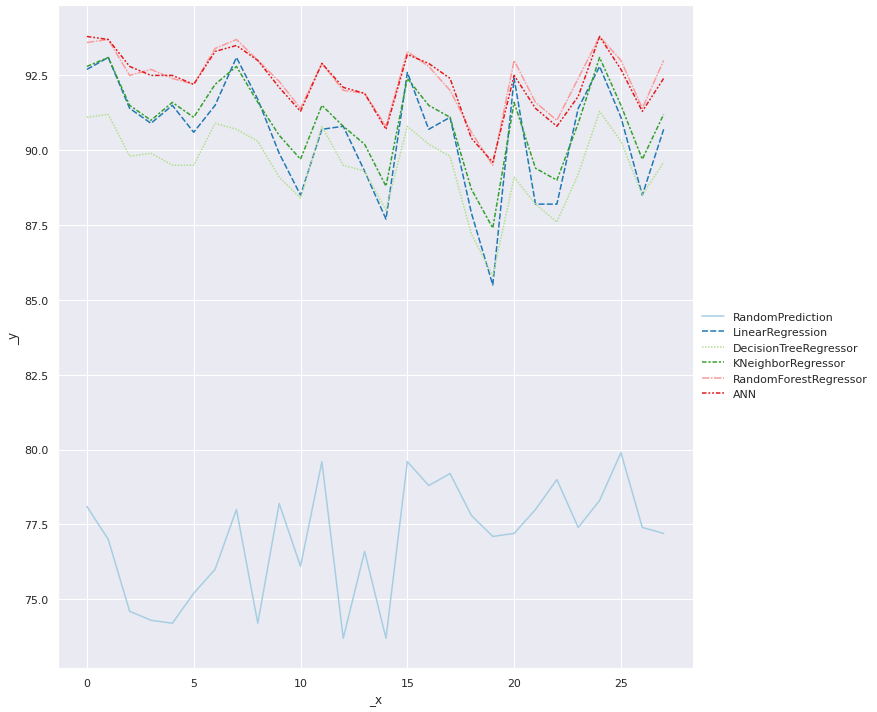

In [ ]:
sns.relplot(kind="line", data=result, height = 10, palette ='Paired',dashes = None)

In [ ]:
r2score = []
i = 0
regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=None,min_samples_split=2, random_state=0,n_jobs=-1)
while i < len(healthdata.columns)-2:
    regr.fit(X_input,Y_input[:, i])
    r2score.append(regr.score(X_output, Y_output[:, i]))
    i += 1

In [ ]:
result['R2'] = r2score

In [ ]:
result['Diffrence from Random Prediction'] = (result["RandomForestRegressor"] - result['RandomPrediction'])/result['RandomPrediction'] *100


In [ ]:
result['Category'] = ['Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Health Outcomes','Prevention','Prevention','Prevention','Prevention','Prevention','Prevention','Prevention','Prevention','Prevention','Prevention','Unhealthy Behaviours','Unhealthy Behaviours','Unhealthy Behaviours','Unhealthy Behaviours']

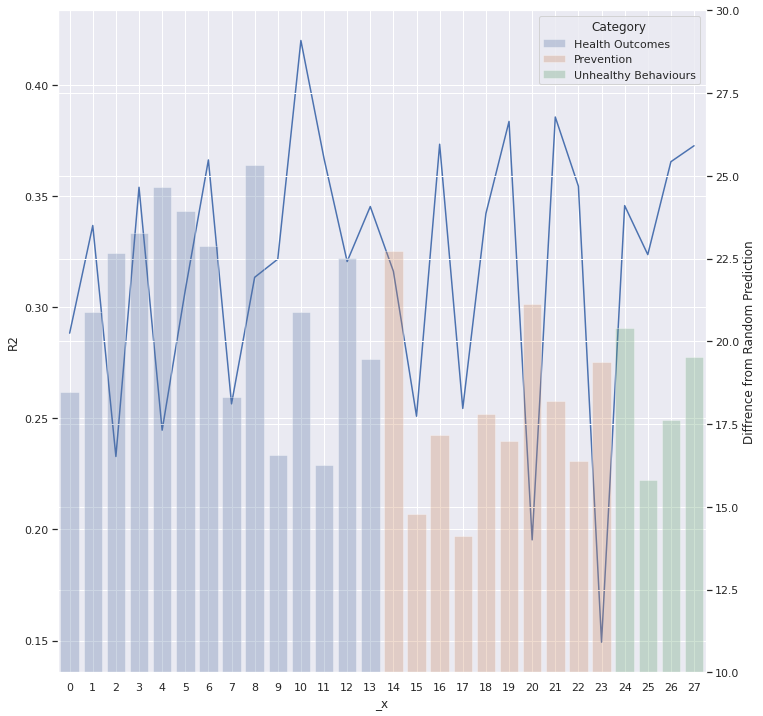

In [ ]:

a = sns.relplot( x = result.index, y='R2',kind="line", data=result,height = 10, palette ='Paired',dashes = None,legend = True)
ax2 = plt.twinx()
ax2.set(ylim=(10, 30))
sns.barplot(x= result.index, y='Diffrence from Random Prediction',hue = 'Category',data = result, ax=ax2,alpha=0.3,dodge = False)



# Visualisation & Optimization 

Partial Dependence

In [ ]:
from sklearn.model_selection import ShuffleSplit
from sklearn.metrics import r2_score
from collections import defaultdict
 
X = X_input
Y = Y_input[:, 10]
names = alldata.iloc[:,:54].columns.tolist()
 
rf = RandomForestRegressor()
scores = defaultdict(list)

rs = ShuffleSplit(n_splits=100, test_size=.25, random_state=0)
 
#crossvalidate the scores on a number of different random splits of the data
for train_idx, test_idx in rs.split(X):
    X_train, X_test = X[train_idx], X[test_idx]
    Y_train, Y_test = Y[train_idx], Y[test_idx]
    r = rf.fit(X_train, Y_train)
    acc = r2_score(Y_test, rf.predict(X_test))
    for i in range(X.shape[1]):
        X_t = X_test.copy()
        np.random.shuffle(X_t[:, i])
        shuff_acc = r2_score(Y_test, rf.predict(X_t))
        scores[names[i]].append((acc-shuff_acc)/acc)
print ("Features sorted by their score:")
print (sorted([(round(np.mean(score), 4), feat) for
              feat, score in scores.items()], reverse=True))

Features sorted by their score:
[(0.5637, 'community_worship'), (0.2508, 'food_cafe'), (0.1956, 'leisure_swimming_pool'), (0.0908, 'transport_platform'), (0.0719, 'food_restaurant'), (0.0675, 'transport_stop_position'), (0.0596, 'transport_bicycle_parking'), (0.0541, 'community_post_box'), (0.0525, 'transport_fuel'), (0.0502, 'area'), (0.0274, 'diversity'), (0.0231, 'transport_parking'), (0.0137, 'sum'), (0.013, 'natural_wood'), (0.0128, 'building_apartments'), (0.0124, 'Population2010'), (0.0123, 'leisure_park'), (0.0107, 'natural_water'), (0.0107, 'community_police'), (0.0098, 'building_retail'), (0.0086, 'leisure_pitch'), (0.0071, 'building_commercial'), (0.0069, 'transport_station'), (0.0068, 'tourism_information'), (0.0066, 'community_community_centre'), (0.0057, 'natural_tree'), (0.0057, 'building_industrial'), (0.0026, 'tourism_hotel'), (0.0026, 'food_bar'), (0.0023, 'shop_clothes'), (0.002, 'natural_peak'), (0.002, 'health_pharmacy'), (0.0018, 'health_dentist'), (0.0017, 'healt

In [ ]:
feature_score2 = pd.DataFrame(sorted([(round(np.mean(score), 4), feat) for feat, score in scores.items()], reverse=True), columns=['score', 'feature'])

In [ ]:
feature_score2

,score,feature
0,0.5637,community_worship
1,0.2508,food_cafe
2,0.1956,leisure_swimming_pool
3,0.0908,transport_platform
4,0.0719,food_restaurant
5,0.0675,transport_stop_position
6,0.0596,transport_bicycle_parking
7,0.0541,community_post_box
8,0.0525,transport_fuel
9,0.0502,area


In [ ]:
X3 = alldata[feature_score2['feature']].copy().fillna(alldata.mean())
y3 = alldata.iloc[:,54:].copy().fillna(alldata.mean())
X_train3, X_test3, y_train3, y_test3 = model_selection.train_test_split(X3, y3, test_size=0.25, random_state=42)

In [ ]:
X_train3

,community_worship,food_cafe,leisure_swimming_pool,transport_platform,food_restaurant,transport_stop_position,transport_bicycle_parking,community_post_box,transport_fuel,area,diversity,transport_parking,sum,natural_wood,building_apartments,Population2010,leisure_park,natural_water,community_police,building_retail,leisure_pitch,building_commercial,transport_station,tourism_information,community_community_centre,natural_tree,building_industrial,tourism_hotel,food_bar,shop_clothes,natural_peak,health_pharmacy,health_dentist,health_clinic,community_post_office,shop_supermarket,food_fast_food,leisure_garden,community_waste_basket,leisure_sports_centre,tourism_attraction,natural_wetland,natural_sand,tourism_viewpoint,shop_bakery,building_greenhouse,community_fire_station,natural_coastline,building_barn,natural_cliff,health_doctors,tourism_artwork,community_recycling,health_hospital
9057,0.002923,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000418,1.134528e+06,0.003340,0.000000,0.005846,0.000000,0.000000,2395.0,0.000418,0.000000,0.000000,0.000000,0.000418,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000418,0.000000,0.000418,0.000000,0.000835,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
10268,0.000490,0.000245,0.000245,0.000490,0.000245,0.000245,0.000000,0.000000,0.000245,2.572971e+06,0.004657,0.001716,0.012255,0.000000,0.001225,4080.0,0.000245,0.000000,0.000000,0.002696,0.000735,0.001716,0.000245,0.0,0.000000,0.000000,0.000000,0.000735,0.000000,0.000000,0.0,0.000245,0.000000,0.000000,0.000000,0.000245,0.000245,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6002,0.000000,0.000336,0.000672,0.001343,0.001343,0.001007,0.001007,0.000000,0.000000,2.236802e+05,0.003358,0.000000,0.008731,0.000000,0.001007,2978.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.001679,0.000000,0.000000,0.000336,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5776,0.001444,0.000000,0.000000,0.005778,0.000000,0.004333,0.000000,0.000000,0.000000,4.614273e+06,0.003852,0.000000,0.014444,0.000000,0.000000,2077.0,0.000000,0.001444,0.000481,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000481,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000481,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9510,0.002416,0.000537,0.000000,0.000000,0.000805,0.000000,0.000268,0.000537,0.000268,2.382233e+06,0.006174,0.005638,0.037047,0.000268,0.003221,3725.0,0.001074,0.000000,0.000000,0.003758,0.000268,0.014228,0.000000,0.0,0.000000,0.000000,0.000000,0.000268,0.000000,0.001074,0.0,0.000268,0.000268,0.000268,0.000537,0.000537,0.000268,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000268,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7180,0.001094,0.000000,0.000000,0.000365,0.000000,0.000000,0.000000,0.000182,0.000000,3.052209e+05,0.001094,0.000000,0.002370,0.000000,0.000000,5486.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000365,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000365,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6337,0.000000,0.000000,0.000302,0.000000,0.000302,0.000000,0.000000,0.000000,0.000000,2.847227e+06,0.002414,0.000000,0.005130,0.000000,0.000000,3314.0,0.000000,0.003319,0.000302,0.000302,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000302,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000302,0.0,0.0,0.0,0.0,0.0,0.0,0.0

In [ ]:
data = X_train3.iloc[:,:].values.tolist()
data2 = y_train3.iloc[:,:].values.tolist()

test = X_test3.iloc[:,:].values.tolist()
test2 = y_test3.iloc[:,:].values.tolist()

maxi = [-math.inf for i in range(len(data[0]))]
mini = [math.inf for i in range(len(data[0]))]

for i in range(len(data)):
    for j in range(len(data[i])):
        if data[i][j]>maxi[j]:
            maxi[j] = data[i][j]
        if data[i][j]<mini[j]:
            mini[j] = data[i][j]

#maxi = [100000000000,200000000000,20]
#mini = [0,0,0]

for i in range(len(data)):
    for j in range(len(data[i])):
        data[i][j] = (data[i][j]-mini[j])/(maxi[j]-mini[j])


for i in range(len(test)):
    for j in range(len(test[i])):
        test[i][j] = (test[i][j]-mini[j])/(maxi[j]-mini[j])

maxi = [-math.inf for i in range(len(data2[0]))]
mini = [math.inf for i in range(len(data2[0]))]

for i in range(len(data2)):
    for j in range(len(data2[i])):
        if data2[i][j]>maxi[j]:
            maxi[j] = data2[i][j]
        if data2[i][j]<mini[j]:
            mini[j] = data2[i][j]



for i in range(len(data2)):
    for j in range(len(data2[i])):
        data2[i][j] = (data2[i][j]-mini[j])/(maxi[j]-mini[j])


for i in range(len(test2)):
    for j in range(len(test2[i])):
        test2[i][j] = (test2[i][j]-mini[j])/(maxi[j]-mini[j])    

In [ ]:

X_input3 = np.array(data)
Y_input3 = np.array(data2)

X_output3 = np.array(test)
Y_output3 = np.array(test2)



In [ ]:
regr_p = RandomForestRegressor(n_estimators=n_estimators, max_depth=None,min_samples_split=2, random_state=0,n_jobs=-1)
regr_p.fit(X_input3,Y_input3[:, 10])


RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=300, n_jobs=-1, oob_score=False,
                      random_state=0, verbose=0, warm_start=False)

In [ ]:
regr_p.score(X_output3, Y_output3[:, 10])

0.4200300771503577

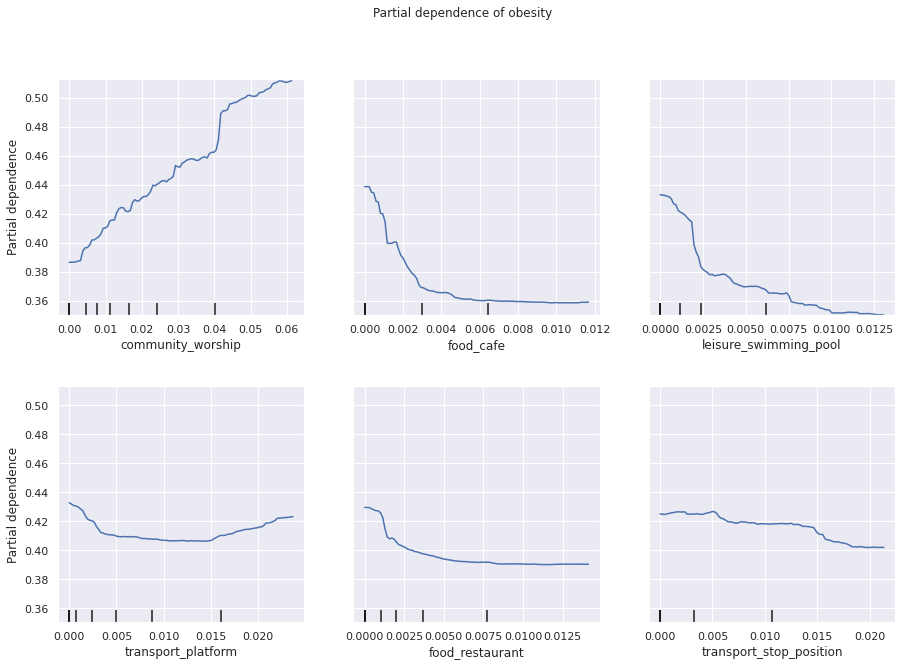

In [ ]:
import matplotlib.pyplot as plt
from sklearn.inspection import partial_dependence
from sklearn.inspection import plot_partial_dependence

fig, ax = plt.subplots(2,3, figsize=(15, 10))
features = ['community_worship', 'food_cafe', 'leisure_swimming_pool', 'transport_platform','food_restaurant','transport_stop_position']
disp1 = plot_partial_dependence(regr_p, X_input3, [0,1,2,3,4,5],feature_names=features,ax=ax)

disp1.figure_.suptitle(
    'Partial dependence of obesity\n'
)
disp1.figure_.subplots_adjust(hspace=0.3)


Plotting on the map

In [ ]:
plot_boundary = gpd.read_file("plotboudary.geojson")
plot_boundary

,ST_x,geometry
0,06,"POLYGON ((-13606067.562 4544993.549, -13606068..."
1,06,"MULTIPOLYGON (((-13608946.922 4548141.098, -13..."
2,06,"POLYGON ((-13608990.630 4548140.130, -13608991..."
3,06,"POLYGON ((-13611773.433 4548349.830, -13611773..."
4,06,"MULTIPOLYGON (((-13612232.849 4546472.684, -13..."
...,...,...
12583,48,"POLYGON ((-10967099.834 4020452.050, -10967057..."
12584,48,"POLYGON ((-10967099.834 4020452.050, -10967137..."
12585,48,"POLYGON ((-10967120.985 4027329.638, -10967125..."
12586,48,"POLYGON ((-10967128.666 4026105.404, -10967129..."


In [ ]:
geodata = plot_boundary.merge(healthdata, left_index= True, right_index=True, suffixes=(False, False))

In [ ]:
geodata

,ST_x,geometry,area,Population2010,ARTHRITIS_CrudePrev,BPHIGH_CrudePrev,CANCER_CrudePrev,CASTHMA_CrudePrev,CHD_CrudePrev,COPD_CrudePrev,DIABETES_CrudePrev,HIGHCHOL_CrudePrev,KIDNEY_CrudePrev,MHLTH_CrudePrev,OBESITY_CrudePrev,PHLTH_CrudePrev,STROKE_CrudePrev,TEETHLOST_CrudePrev,ACCESS2_CrudePrev,BPMED_CrudePrev,CHECKUP_CrudePrev,CHOLSCREEN_CrudePrev,COLON_SCREEN_CrudePrev,DENTAL_CrudePrev,MAMMOUSE_CrudePrev,COREM_CrudePrev,COREW_CrudePrev,PAPTEST_CrudePrev,BINGE_CrudePrev,CSMOKING_CrudePrev,LPA_CrudePrev,SLEEP_CrudePrev
0,06,"POLYGON ((-13606067.562 4544993.549, -13606068...",1.645791e+06,3646.0,21.9,27.3,7.7,8.3,5.4,4.7,8.5,32.4,2.6,9.1,19.2,9.6,2.5,6.9,5.9,74.4,69.7,85.2,75.3,76.4,79.4,39.3,36.9,84.3,18.3,10.9,14.7,31.1
1,06,"MULTIPOLYGON (((-13608946.922 4548141.098, -13...",2.132769e+06,4107.0,18.0,25.3,5.2,8.5,4.5,4.5,9.3,31.2,2.5,10.8,19.7,10.1,2.3,8.7,8.5,71.0,66.1,77.2,67.9,67.6,78.9,33.4,32.8,81.1,17.7,13.6,18.1,35.6
2,06,"POLYGON ((-13608990.630 4548140.130, -13608991...",3.131895e+06,4896.0,21.4,29.6,6.5,8.7,5.8,5.3,10.6,34.5,2.8,10.3,19.5,10.9,2.8,9.6,8.3,75.0,68.7,79.5,70.0,68.1,78.1,34.4,33.5,80.6,15.8,13.0,18.9,34.4
3,06,"POLYGON ((-13611773.433 4548349.830, -13611773...",9.345803e+05,4722.0,17.5,27.0,4.2,9.6,4.6,5.2,10.7,31.5,2.8,13.5,21.8,12.1,2.8,14.8,12.3,69.6,64.6,68.3,60.0,55.5,78.0,27.1,26.9,79.2,14.8,16.8,23.4,39.3
4,06,"MULTIPOLYGON (((-13612232.849 4546472.684, -13...",1.623464e+06,4866.0,17.9,25.0,5.6,8.3,4.4,4.2,8.4,30.8,2.3,9.8,19.0,9.2,2.1,7.5,7.3,71.3,66.9,79.4,72.1,71.7,79.0,36.5,35.8,82.1,18.3,12.2,15.9,34.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12583,48,"POLYGON ((-10967099.834 4020452.050, -10967057...",4.834685e+06,2393.0,28.2,38.5,5.9,10.3,8.2,9.4,15.7,43.1,3.7,16.3,35.9,17.2,4.4,20.7,25.4,77.9,70.7,68.8,54.3,48.7,75.2,25.7,27.3,79.7,14.7,26.8,37.2,41.3
12584,48,"POLYGON ((-10967099.834 4020452.050, -10967137...",4.827368e+07,7551.0,19.2,32.4,4.0,8.5,5.4,6.1,11.7,35.7,2.5,13.6,35.5,13.0,2.8,16.2,28.5,69.3,67.5,67.7,56.5,51.3,74.6,28.0,32.1,78.7,21.2,27.2,31.2,43.3
12585,48,"POLYGON ((-10967120.985 4027329.638, -10967125...",1.323610e+07,6406.0,23.6,33.3,5.5,9.3,5.9,6.2,12.5,37.0,2.9,12.8,32.2,12.2,3.2,12.4,17.5,77.1,72.1,74.2,63.5,60.6,79.0,29.5,32.1,82.3,16.9,20.2,27.3,39.3
12586,48,"POLYGON ((-10967128.666 4026105.404, -10967129...",8.107497e+05,1375.0,8.7,14.6,2.0,8.9,1.3,2.8,3.1,19.1,1.2,13.4,27.0,7.0,0.8,7.3,17.0,43.2,63.3,64.0,55.4,64.6,77.5,31.3,NaN,83.4,26.1,21.7,18.6,40.2


In [ ]:
state = geodata[geodata['ST_x']== '06']

In [ ]:
state2 = geodata[geodata['ST_x']== '48']

In [ ]:
state3 = geodata[geodata['ST_x']== '12']

In [ ]:
state4 = geodata[geodata['ST_x']== '36']

In [ ]:
state5 = geodata[geodata['ST_x']== '42']

In [ ]:
staten = np.array(state)

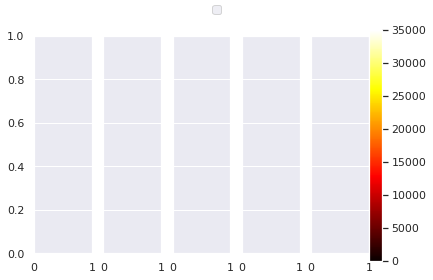

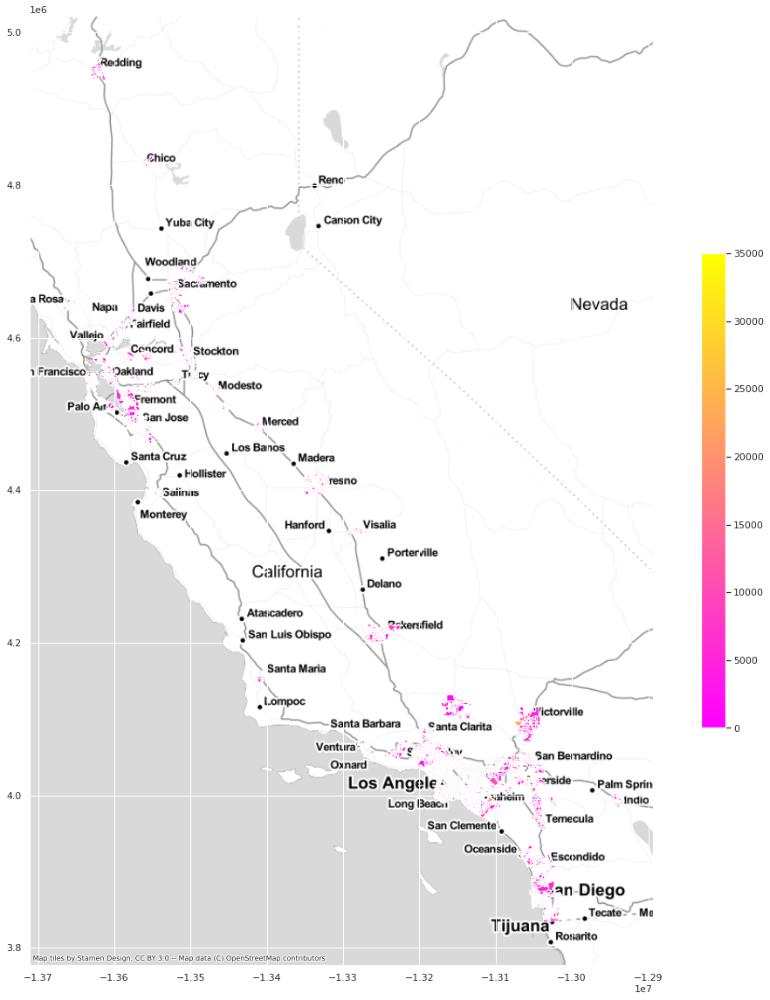

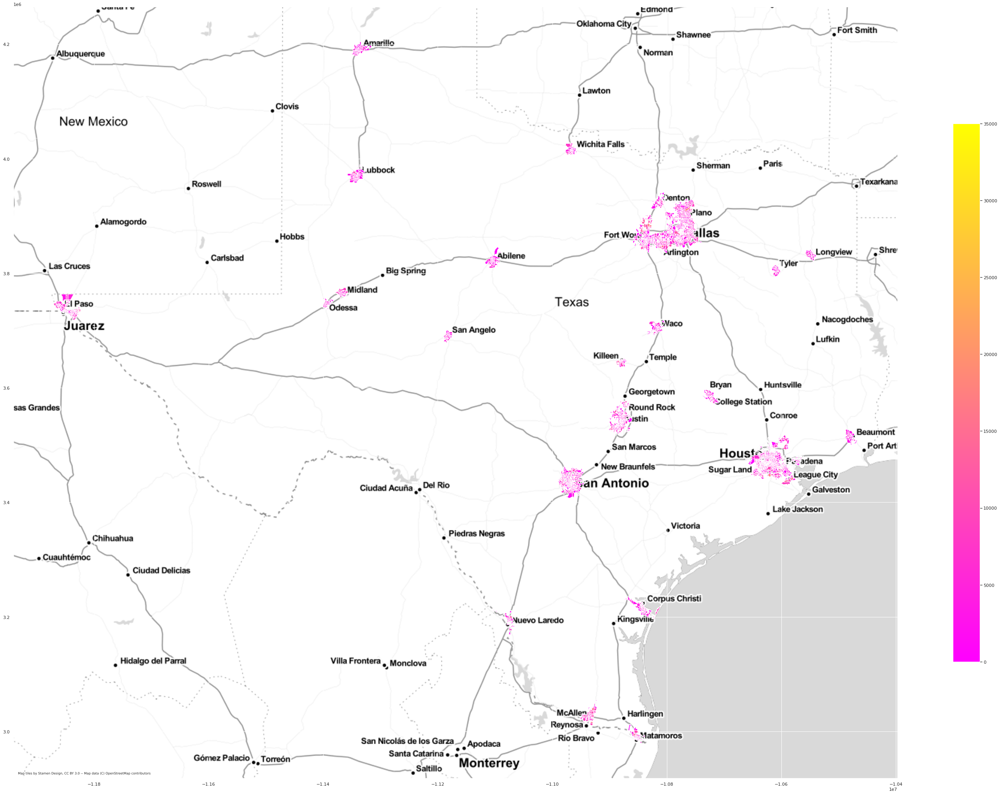

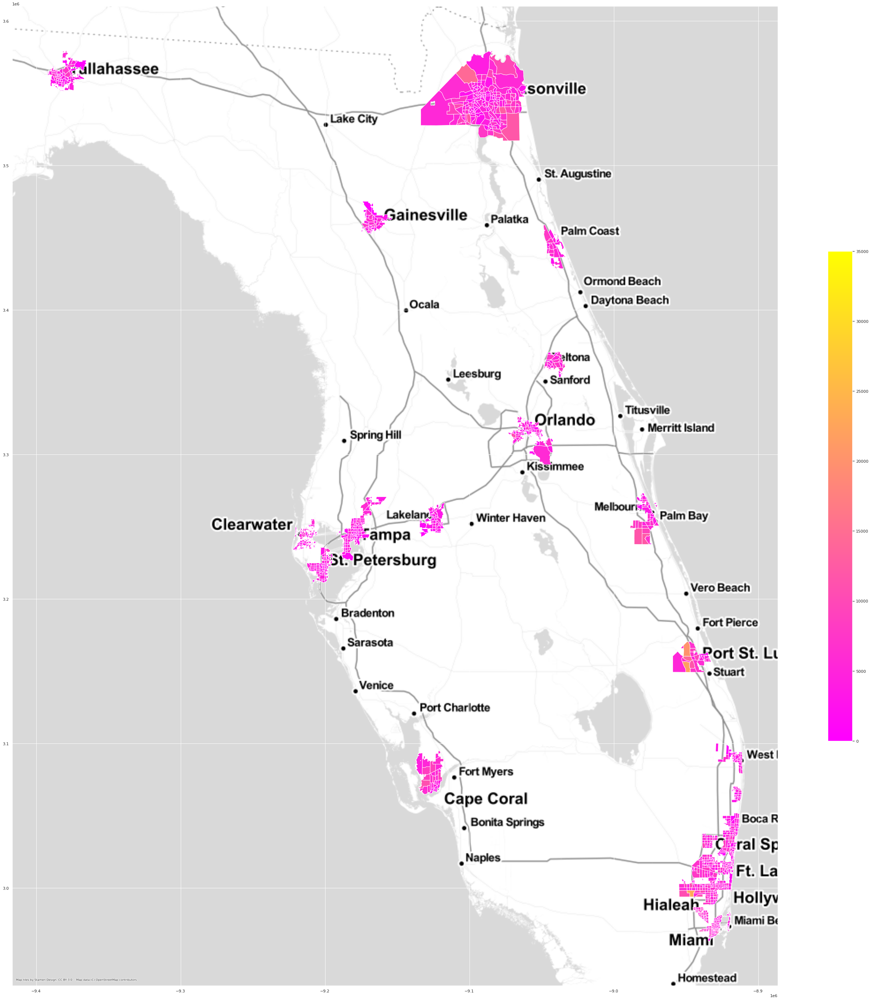

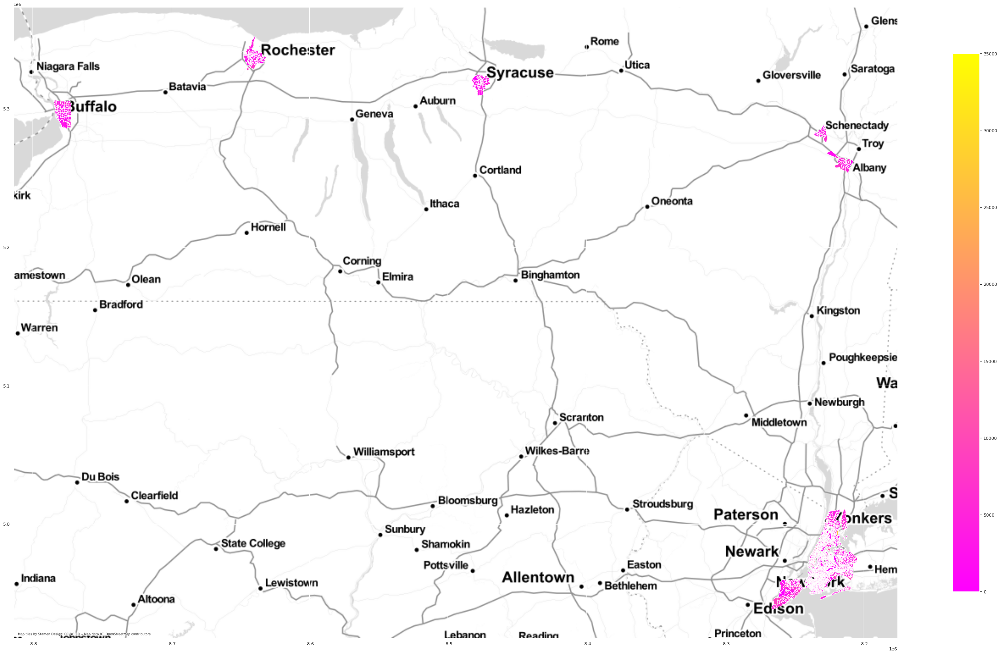

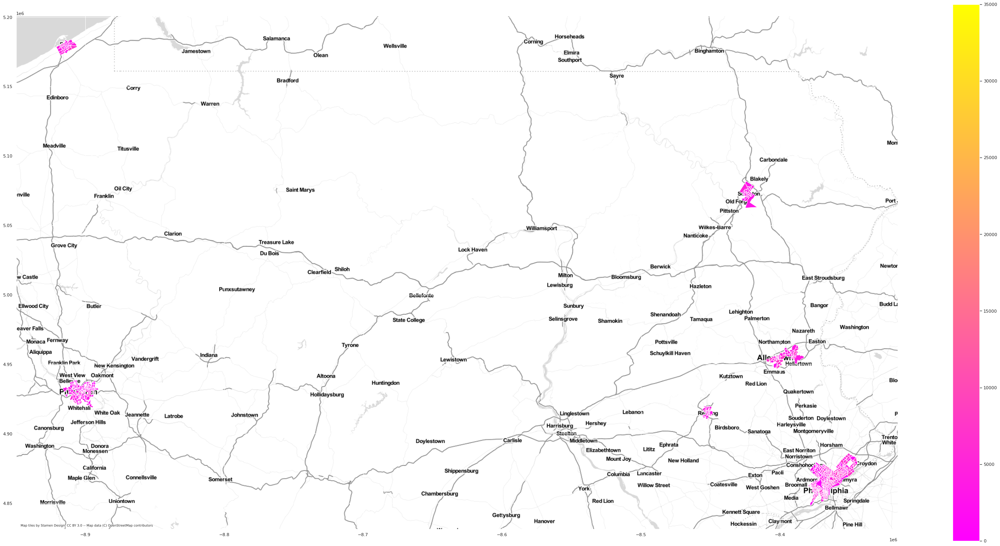

In [ ]:

min = 0
max = 35000

fig, (ax1, ax2,ax3,ax4,ax5) = plt.subplots(1, 5,sharey= True)
ax1 = state.plot(figsize = (20, 20),column = 'Population2010',legend = True,cmap='spring',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax1, url=ctx.providers.Stamen.TonerLite)
ax2 = state2.plot(figsize = (50, 50),column = 'Population2010',legend = True,cmap='spring',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax2, url=ctx.providers.Stamen.TonerLite)
ax3 = state3.plot(figsize = (50, 50),column = 'Population2010',legend = True,cmap='spring',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax3, url=ctx.providers.Stamen.TonerLite)
ax4 = state4.plot(figsize = (50, 50),column = 'Population2010',legend = True,cmap='spring',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax4, url=ctx.providers.Stamen.TonerLite)
ax5 = state5.plot(figsize = (50, 50),column = 'Population2010',legend = True,cmap='spring',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax5, url=ctx.providers.Stamen.TonerLite)
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center')

cax = fig.add_axes([0.9, 0.1, 0.03, 0.8])
sm = plt.cm.ScalarMappable(cmap='hot', norm=plt.Normalize(vmin=min, vmax=max))
sm._A = []
fig.colorbar(sm, cax=cax)



Change data by 10% and see the prediction change

In [ ]:
X_output3

array([[0.04851752, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.00901172, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.00579151, 0.        , 0.00370094, ..., 0.        , 0.        ,
        0.        ],
       [0.00702412, 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [ ]:
a = X_output3.copy()

In [ ]:
X_testmodified = a.copy()

In [ ]:
X_testmodified[:,5] = X_testmodified[:,5] * 1.1

In [ ]:
preds = regr_p.predict(a)
preds = pd.DataFrame(preds)

In [ ]:
predmodified =  regr_p.predict(X_testmodified)
predmodified = pd.DataFrame(predmodified)

In [ ]:
testdata = plot_boundary.merge(y_test3, left_index= True, right_index=True, suffixes=(False, False))

In [ ]:
testdata

,ST_x,geometry,ARTHRITIS_CrudePrev,BPHIGH_CrudePrev,CANCER_CrudePrev,CASTHMA_CrudePrev,CHD_CrudePrev,COPD_CrudePrev,DIABETES_CrudePrev,HIGHCHOL_CrudePrev,KIDNEY_CrudePrev,MHLTH_CrudePrev,OBESITY_CrudePrev,PHLTH_CrudePrev,STROKE_CrudePrev,TEETHLOST_CrudePrev,ACCESS2_CrudePrev,BPMED_CrudePrev,CHECKUP_CrudePrev,CHOLSCREEN_CrudePrev,COLON_SCREEN_CrudePrev,DENTAL_CrudePrev,MAMMOUSE_CrudePrev,COREM_CrudePrev,COREW_CrudePrev,PAPTEST_CrudePrev,BINGE_CrudePrev,CSMOKING_CrudePrev,LPA_CrudePrev,SLEEP_CrudePrev
0,06,"POLYGON ((-13606067.562 4544993.549, -13606068...",21.9,27.3,7.7,8.3,5.4,4.7,8.5,32.4,2.6,9.1,19.2,9.6,2.5,6.9,5.9,74.4,69.7,85.2,75.3,76.4,79.4,39.3,36.9,84.3,18.3,10.9,14.7,31.1
3,06,"POLYGON ((-13611773.433 4548349.830, -13611773...",17.5,27.0,4.2,9.6,4.6,5.2,10.7,31.5,2.8,13.5,21.8,12.1,2.8,14.8,12.3,69.6,64.6,68.3,60.0,55.5,78.0,27.1,26.9,79.2,14.8,16.8,23.4,39.3
8,06,"POLYGON ((-13606067.562 4544993.549, -13606071...",19.2,25.1,6.2,8.6,4.6,4.6,8.1,31.1,2.3,9.9,19.7,9.6,2.2,7.5,6.9,71.1,67.2,81.3,72.6,73.6,79.6,37.8,37.1,83.7,19.2,12.2,15.2,32.8
10,06,"POLYGON ((-13606200.319 4543875.784, -13606200...",18.2,25.5,6.3,7.5,4.5,3.7,8.5,31.8,2.3,8.3,15.9,8.2,2.0,6.0,6.0,74.1,69.2,82.7,73.1,75.5,78.6,38.7,38.3,80.6,16.3,9.8,14.9,33.1
12,06,"POLYGON ((-13608168.128 4545927.870, -13608182...",20.6,27.9,6.7,8.5,5.4,4.8,9.3,32.2,2.7,9.9,19.3,10.0,2.7,8.7,7.7,74.4,68.5,80.3,71.6,70.9,79.0,35.6,33.3,82.5,17.1,12.1,17.2,33.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12546,48,"POLYGON ((-10816820.360 3703755.196, -10816867...",25.4,34.5,5.2,10.3,7.1,7.9,13.7,38.6,3.6,15.8,41.0,16.2,4.1,23.7,31.1,75.9,67.8,65.5,53.6,48.6,74.9,25.8,21.4,80.7,15.1,22.7,35.6,36.8
12561,48,"POLYGON ((-10965380.726 4015725.421, -10965381...",26.5,35.9,5.1,10.4,8.0,9.5,15.6,41.7,3.8,17.6,37.3,18.3,4.4,23.3,30.4,74.8,68.2,65.1,49.9,43.8,76.1,23.2,24.3,79.8,14.5,28.2,39.6,41.8
12573,48,"POLYGON ((-10964355.696 4013324.354, -10964523...",21.7,29.1,5.9,8.6,5.6,5.4,9.3,36.6,2.4,11.5,26.3,10.2,2.5,9.5,13.7,75.8,71.1,72.5,65.6,68.4,77.9,34.7,35.7,81.0,18.8,16.3,22.2,34.9
12578,48,"POLYGON ((-10971762.006 4011574.698, -10971762...",25.3,33.3,7.0,8.6,6.5,6.2,10.9,39.6,2.7,11.4,27.7,11.5,2.9,10.3,14.9,78.4,72.4,77.4,66.0,67.3,76.9,34.1,35.4,81.6,17.5,18.1,25.1,35.6


In [ ]:
ytest= pd.DataFrame(test2)

In [ ]:
ytest = ytest[10]

In [ ]:
ytest

0       0.733485
1       0.346241
2       0.419134
3       0.309795
4       0.243736
          ...   
2412    0.298405
2413    0.548975
2414    0.548975
2415    0.769932
2416    0.334852
Name: 10, Length: 2417, dtype: float64

In [ ]:
testdata = testdata.reset_index()

In [ ]:
process = testdata.merge(preds, left_index= True, right_index=True, suffixes=(False, False))

In [ ]:
process2 = process.merge(predmodified, left_index= True, right_index=True, suffixes=(False, True))

In [ ]:
process3 = process2.merge(ytest, left_index= True, right_index=True, suffixes=(False, True))

In [ ]:
process3

,index,ST_x,geometry,ARTHRITIS_CrudePrev,BPHIGH_CrudePrev,CANCER_CrudePrev,CASTHMA_CrudePrev,CHD_CrudePrev,COPD_CrudePrev,DIABETES_CrudePrev,HIGHCHOL_CrudePrev,KIDNEY_CrudePrev,MHLTH_CrudePrev,OBESITY_CrudePrev,PHLTH_CrudePrev,STROKE_CrudePrev,TEETHLOST_CrudePrev,ACCESS2_CrudePrev,BPMED_CrudePrev,CHECKUP_CrudePrev,CHOLSCREEN_CrudePrev,COLON_SCREEN_CrudePrev,DENTAL_CrudePrev,MAMMOUSE_CrudePrev,COREM_CrudePrev,COREW_CrudePrev,PAPTEST_CrudePrev,BINGE_CrudePrev,CSMOKING_CrudePrev,LPA_CrudePrev,SLEEP_CrudePrev,0False,0True,10
0,0,06,"POLYGON ((-13606067.562 4544993.549, -13606068...",21.9,27.3,7.7,8.3,5.4,4.7,8.5,32.4,2.6,9.1,19.2,9.6,2.5,6.9,5.9,74.4,69.7,85.2,75.3,76.4,79.4,39.3,36.9,84.3,18.3,10.9,14.7,31.1,0.549370,0.549370,0.733485
1,3,06,"POLYGON ((-13611773.433 4548349.830, -13611773...",17.5,27.0,4.2,9.6,4.6,5.2,10.7,31.5,2.8,13.5,21.8,12.1,2.8,14.8,12.3,69.6,64.6,68.3,60.0,55.5,78.0,27.1,26.9,79.2,14.8,16.8,23.4,39.3,0.455733,0.455733,0.346241
2,8,06,"POLYGON ((-13606067.562 4544993.549, -13606071...",19.2,25.1,6.2,8.6,4.6,4.6,8.1,31.1,2.3,9.9,19.7,9.6,2.2,7.5,6.9,71.1,67.2,81.3,72.6,73.6,79.6,37.8,37.1,83.7,19.2,12.2,15.2,32.8,0.397358,0.397973,0.419134
3,10,06,"POLYGON ((-13606200.319 4543875.784, -13606200...",18.2,25.5,6.3,7.5,4.5,3.7,8.5,31.8,2.3,8.3,15.9,8.2,2.0,6.0,6.0,74.1,69.2,82.7,73.1,75.5,78.6,38.7,38.3,80.6,16.3,9.8,14.9,33.1,0.461655,0.461655,0.309795
4,12,06,"POLYGON ((-13608168.128 4545927.870, -13608182...",20.6,27.9,6.7,8.5,5.4,4.8,9.3,32.2,2.7,9.9,19.3,10.0,2.7,8.7,7.7,74.4,68.5,80.3,71.6,70.9,79.0,35.6,33.3,82.5,17.1,12.1,17.2,33.3,0.313113,0.313113,0.243736
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2412,12546,48,"POLYGON ((-10816820.360 3703755.196, -10816867...",25.4,34.5,5.2,10.3,7.1,7.9,13.7,38.6,3.6,15.8,41.0,16.2,4.1,23.7,31.1,75.9,67.8,65.5,53.6,48.6,74.9,25.8,21.4,80.7,15.1,22.7,35.6,36.8,0.390683,0.396773,0.298405
2413,12561,48,"POLYGON ((-10965380.726 4015725.421, -10965381...",26.5,35.9,5.1,10.4,8.0,9.5,15.6,41.7,3.8,17.6,37.3,18.3,4.4,23.3,30.4,74.8,68.2,65.1,49.9,43.8,76.1,23.2,24.3,79.8,14.5,28.2,39.6,41.8,0.447669,0.447669,0.548975
2414,12573,48,"POLYGON ((-10964355.696 4013324.354, -10964523...",21.7,29.1,5.9,8.6,5.6,5.4,9.3,36.6,2.4,11.5,26.3,10.2,2.5,9.5,13.7,75.8,71.1,72.5,65.6,68.4,77.9,34.7,35.7,81.0,18.8,16.3,22.2,34.9,0.430433,0.430433,0.548975
2415,12578,48,"POLYGON ((-10971762.006 4011574.698, -10971762...",25.3,33.3,7.0,8.6,6.5,6.2,10.9,39.6,2.7,11.4,27.7,11.5,2.9,10.3,14.9,78.4,72.4,77.4,66.0,67.3,76.9,34.1,35.4,81.6,17.5,18.1,25.1,35.6,0.530061,0.530061,0.769932


In [ ]:
process3.describe()

,index,ARTHRITIS_CrudePrev,BPHIGH_CrudePrev,CANCER_CrudePrev,CASTHMA_CrudePrev,CHD_CrudePrev,COPD_CrudePrev,DIABETES_CrudePrev,HIGHCHOL_CrudePrev,KIDNEY_CrudePrev,MHLTH_CrudePrev,OBESITY_CrudePrev,PHLTH_CrudePrev,STROKE_CrudePrev,TEETHLOST_CrudePrev,ACCESS2_CrudePrev,BPMED_CrudePrev,CHECKUP_CrudePrev,CHOLSCREEN_CrudePrev,COLON_SCREEN_CrudePrev,DENTAL_CrudePrev,MAMMOUSE_CrudePrev,COREM_CrudePrev,COREW_CrudePrev,PAPTEST_CrudePrev,BINGE_CrudePrev,CSMOKING_CrudePrev,LPA_CrudePrev,SLEEP_CrudePrev,0False,0True,10
count,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000,2417.000000
mean,6045.927596,19.778734,28.314646,5.248614,9.024700,5.438436,5.694456,10.552586,33.787216,2.865412,12.579272,27.503020,12.297724,2.948159,14.404895,17.559206,70.664915,68.536823,72.773769,61.769810,61.040960,79.361620,30.390860,29.799571,82.659702,17.886305,15.896690,24.978279,36.298511,0.419019,0.418695,0.419203
std,3643.913011,5.551279,6.859352,1.724348,1.643427,1.919773,2.067360,3.829684,4.988321,0.881686,3.230100,7.550235,3.957605,1.286380,7.889696,10.021342,7.059452,5.735706,8.516851,9.028016,12.832438,2.503273,7.449493,6.836827,3.001396,3.754156,5.040347,9.032903,4.921500,0.108903,0.109080,0.171987
min,0.000000,2.000000,5.700000,0.600000,5.400000,0.500000,1.400000,0.800000,15.500000,0.500000,5.400000,11.000000,3.500000,0.200000,2.800000,3.300000,41.000000,51.400000,33.600000,33.300000,22.700000,70.400000,13.300000,10.700000,68.800000,4.200000,4.900000,7.100000,22.800000,0.117563,0.117563,0.043280
25%,2791.000000,16.200000,24.400000,4.100000,7.900000,4.200000,4.200000,7.900000,31.100000,2.300000,10.100000,21.700000,9.300000,2.100000,8.000000,9.500000,66.700000,64.400000,67.400000,55.300000,51.400000,77.900000,24.400000,24.600000,81.000000,15.500000,12.100000,17.800000,32.700000,0.349514,0.349393,0.287016
50%,5781.000000,19.200000,27.600000,5.000000,8.700000,5.300000,5.400000,10.000000,33.900000,2.700000,12.100000,26.700000,11.700000,2.700000,12.700000,15.600000,71.200000,67.800000,73.600000,62.600000,62.500000,79.400000,30.900000,29.900000,83.000000,17.500000,15.400000,24.000000,36.000000,0.418869,0.418595,0.400911
75%,9266.000000,22.900000,31.700000,6.200000,9.800000,6.400000,6.800000,12.600000,36.800000,3.300000,14.900000,32.400000,14.900000,3.500000,18.900000,23.400000,75.400000,72.400000,79.000000,68.800000,71.500000,80.900000,35.900000,35.100000,84.700000,19.800000,18.900000,30.800000,39.400000,0.481405,0.480972,0.530752
max,12585.000000,43.800000,54.900000,12.500000,16.300000,12.800000,14.400000,27.100000,53.300000,6.700000,23.200000,51.500000,31.600000,7.800000,51.800000,58.500000,89.100000,89.100000,94.000000,80.900000,87.200000,87.100000,54.500000,50.900000,89.200000,32.600000,39.300000,62.100000,52.300000,0.873181,0.873181,0.965831


In [ ]:
process2['delta'] = process2['0True'] - process2['0False']

In [ ]:
process2['delta'].mean()

-0.00032405238897219063

In [ ]:
process3['delta'] = process3['0False'] - process3[10]

In [ ]:
process3['delta'].mean()

-0.0001672379491132629

In [ ]:
#06 48 12 36 42
state = process3[process3['ST_x']== '06']

In [ ]:
state2 = process3[process3['ST_x']== '48']

In [ ]:
state3 = process3[process3['ST_x']== '12']

In [ ]:
state4 = process3[process3['ST_x']== '36']

In [ ]:
state5 = process3[process3['ST_x']== '42']

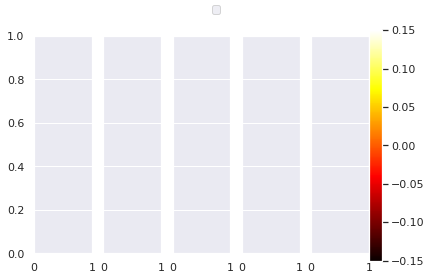

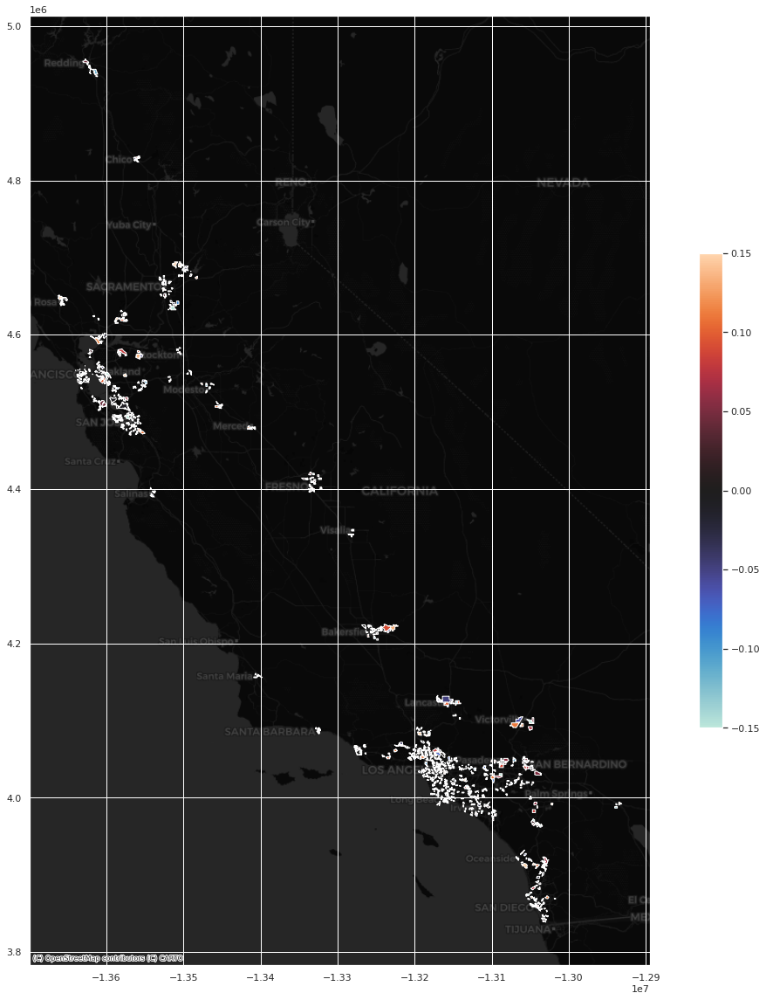

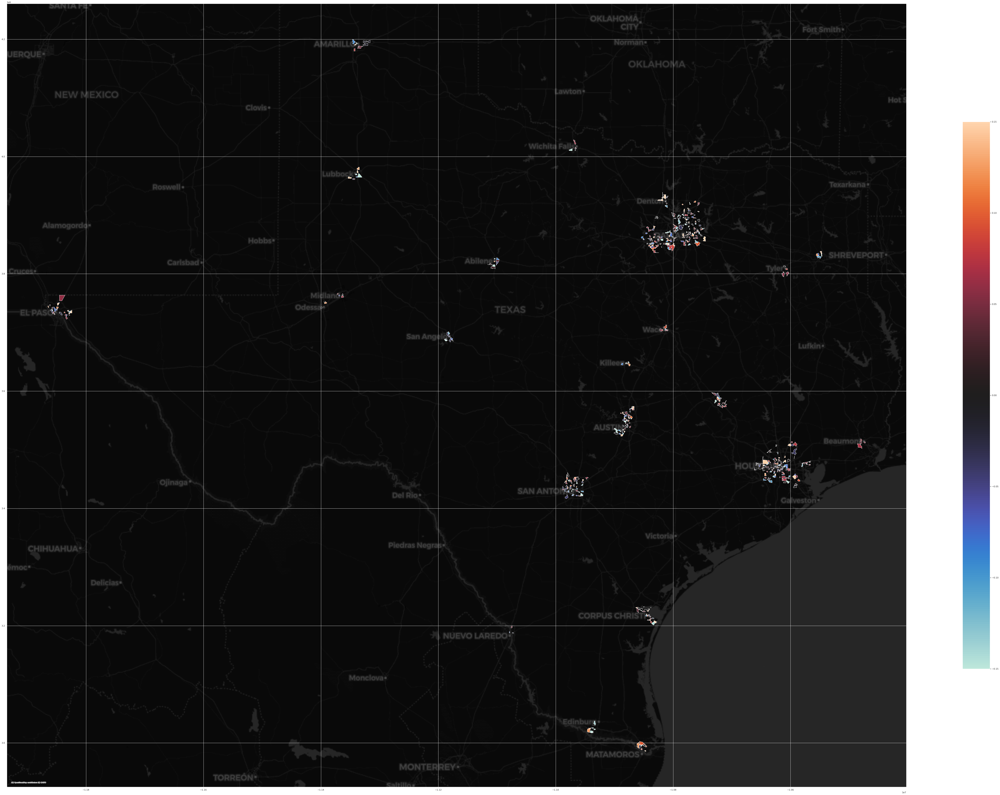

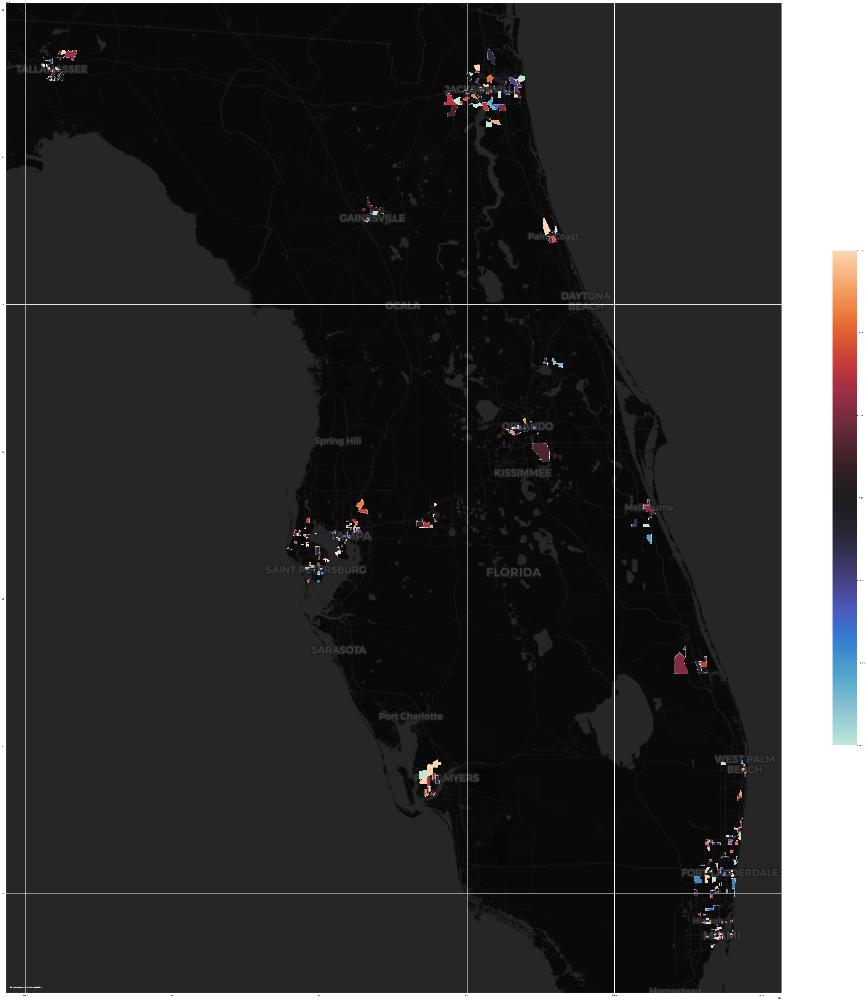

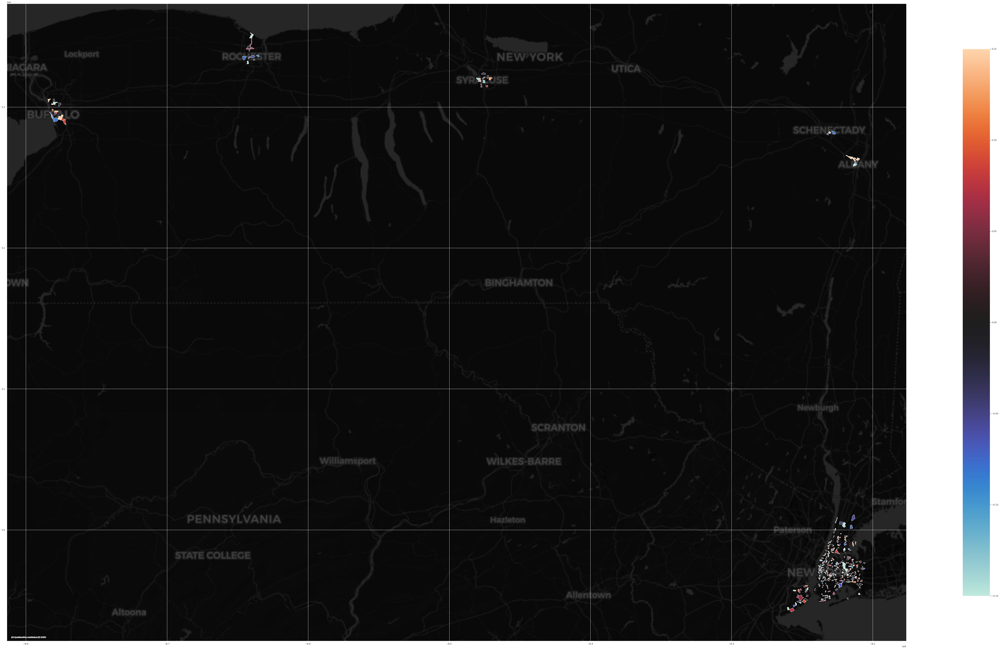

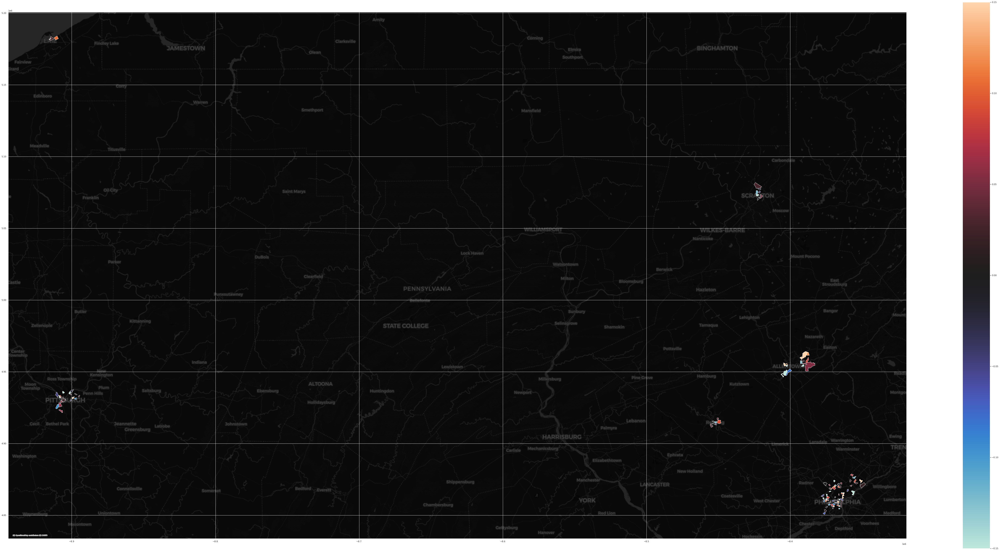

In [ ]:

min = -0.15
max = 0.15

fig, (ax1, ax2,ax3,ax4,ax5) = plt.subplots(1, 5,sharey= True)
ax1 = state.plot(figsize = (20, 20),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax1, url=ctx.providers.CartoDB.DarkMatter)
ax2 = state2.plot(figsize = (100, 100),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax2, url=ctx.providers.CartoDB.DarkMatter)
ax3 = state3.plot(figsize = (100, 100),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax3, url=ctx.providers.CartoDB.DarkMatter)
ax4 = state4.plot(figsize = (100, 100),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax4, url=ctx.providers.CartoDB.DarkMatter)
ax5 = state5.plot(figsize = (100, 100),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax5, url=ctx.providers.CartoDB.DarkMatter)
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center')

cax = fig.add_axes([0.9, 0.1, 0.03, 0.8])
sm = plt.cm.ScalarMappable(cmap='hot', norm=plt.Normalize(vmin=min, vmax=max))
sm._A = []
fig.colorbar(sm, cax=cax)

In [ ]:
#06 48 12 36 42
state = process3[process3['ST_x']== '06']

In [ ]:
state2 = process3[process3['ST_x']== '48']

In [ ]:
state3 = process3[process3['ST_x']== '12']

In [ ]:
state4 = process3[process3['ST_x']== '36']

In [ ]:
state5 = process3[process3['ST_x']== '42']

AttributeError: ignored

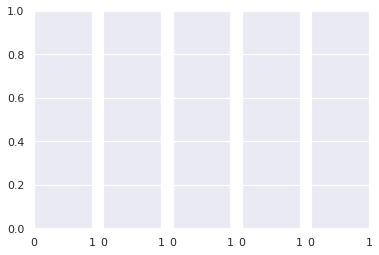

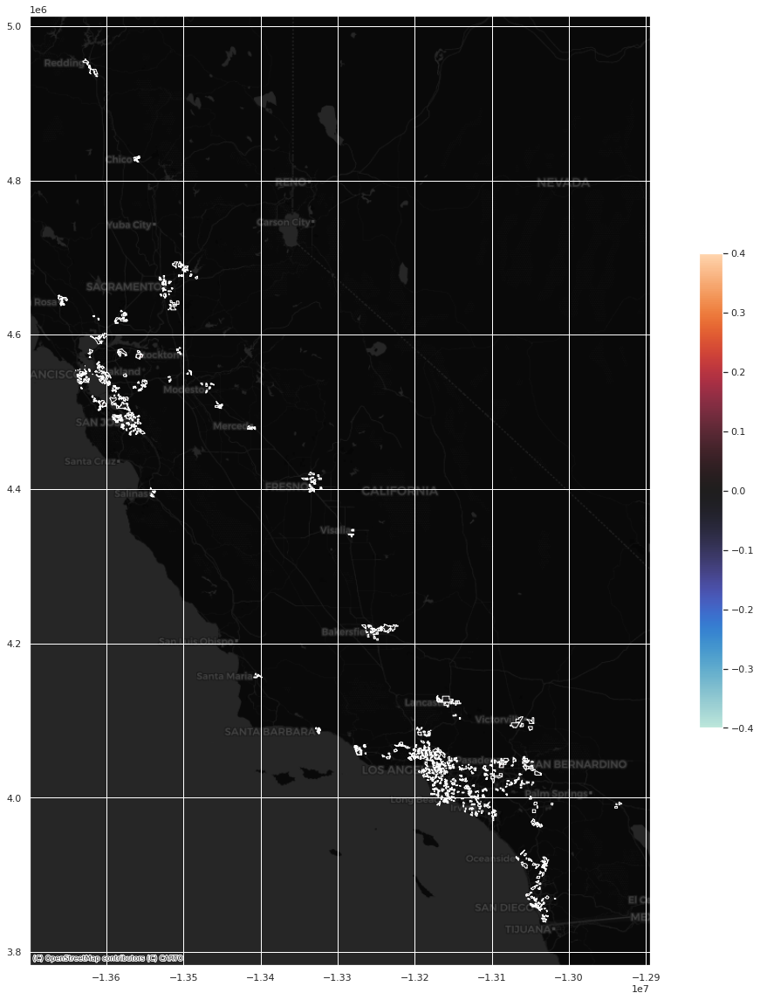

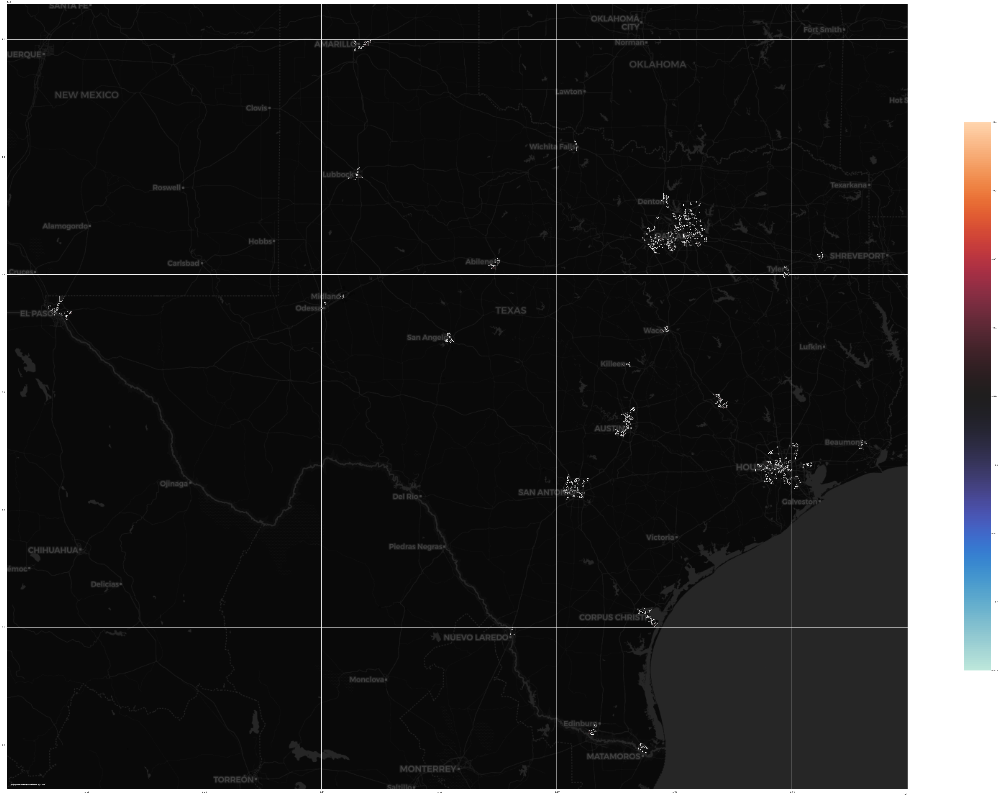

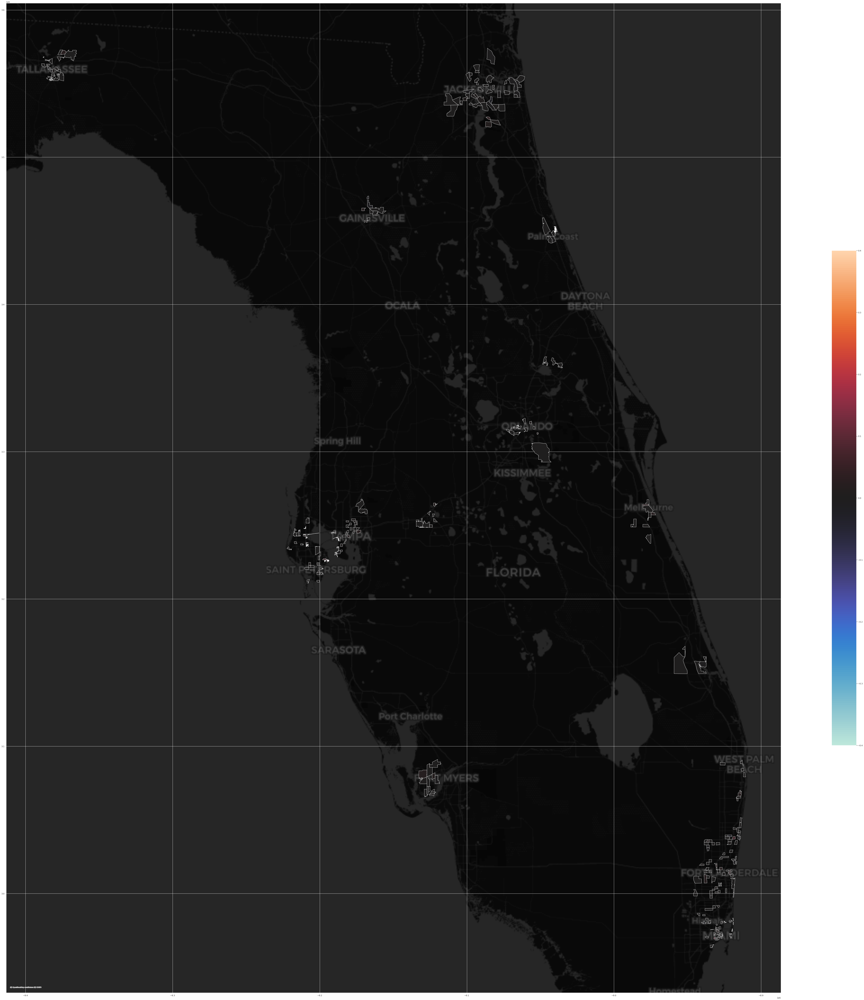

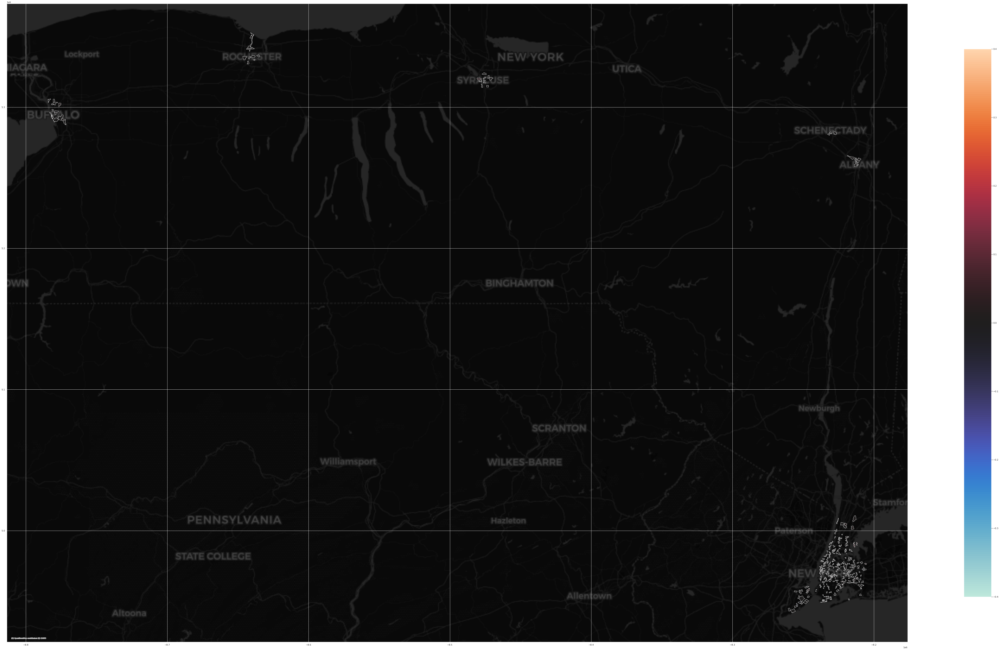

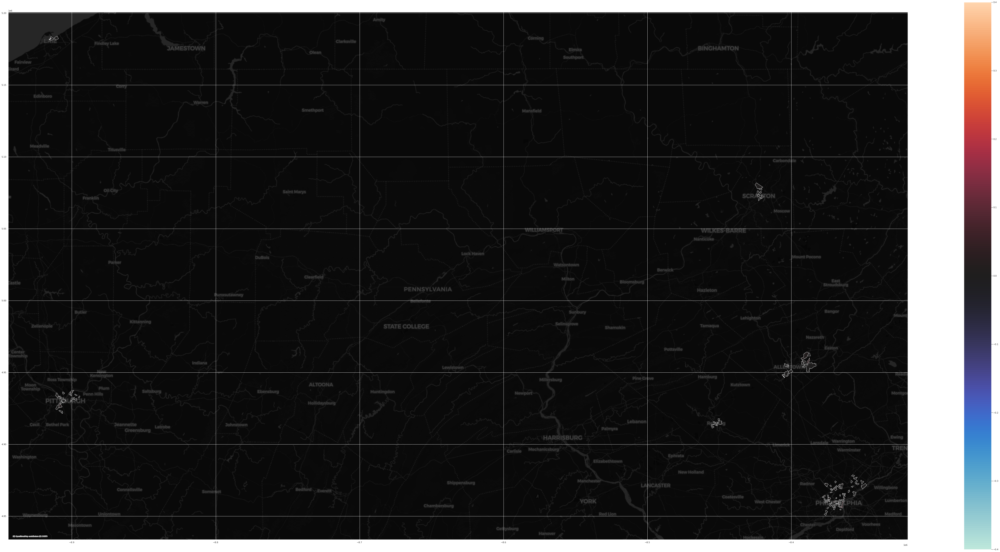

In [ ]:

min = -0.4
max = 0.4

fig, (ax1, ax2,ax3,ax4,ax5) = plt.subplots(1, 5,sharey= True)
ax1 = state.plot(figsize = (20, 20),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax1, url=ctx.providers.CartoDB.DarkMatter)
ax2 = state2.plot(figsize = (100, 100),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax2, url=ctx.providers.CartoDB.DarkMatter)
ax3 = state3.plot(figsize = (100, 100),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax3, url=ctx.providers.CartoDB.DarkMatter)
ax4 = state4.plot(figsize = (100, 100),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax4, url=ctx.providers.CartoDB.DarkMatter)
ax5 = state5.plot(figsize = (100, 100),column = 'delta',legend = True,cmap='icefire',vmin=min, vmax=max,legend_kwds={'shrink': 0.5})
ctx.add_basemap(ax5, url=ctx.providers.CartoDB.DarkMatter)
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='upper center')

cax = fig.add_axes([0.9, 0.1, 0.03, 0.8])
sm = plt.cm.ScalarMappable(cmap='hot', norm=plt.Normalize(vmin=min, vmax=max))
sm._A = []
fig.colorbar(sm, cax=cax)

In [ ]:
corr_score = alldata[list(alldata.columns)[:54]].corr()

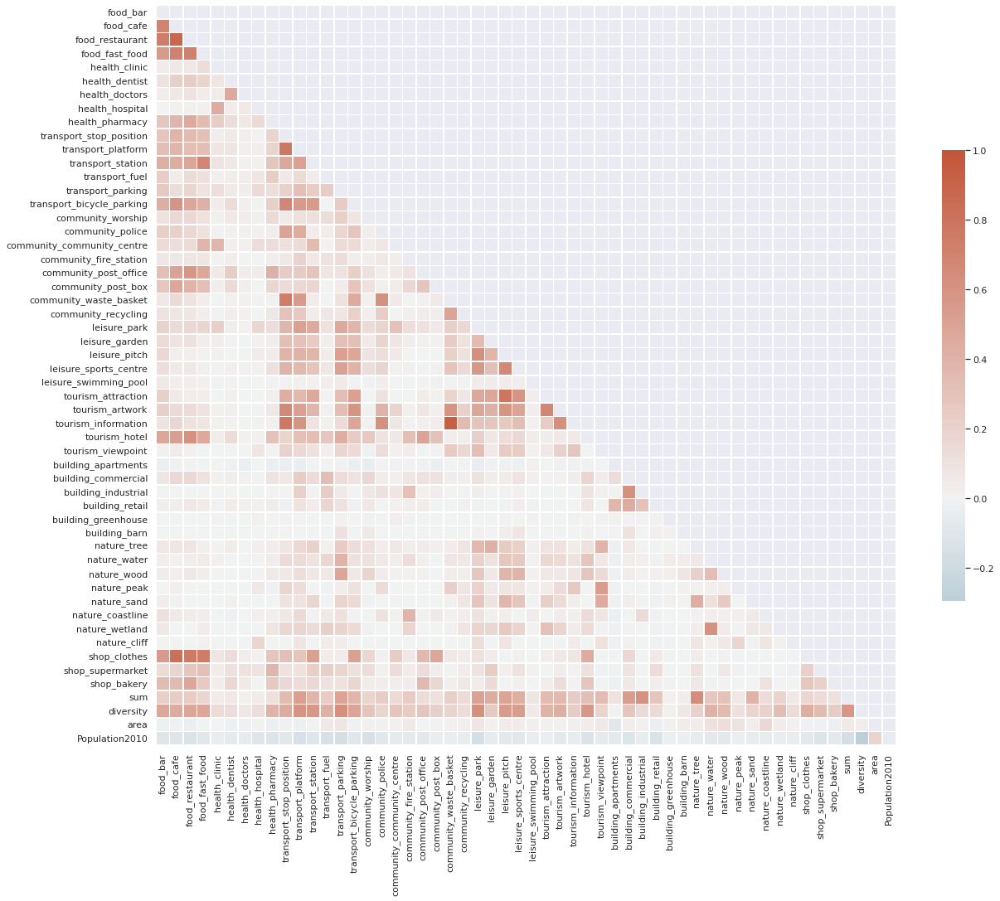

In [ ]:
mask = np.triu(np.ones_like(corr_score, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr_score, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

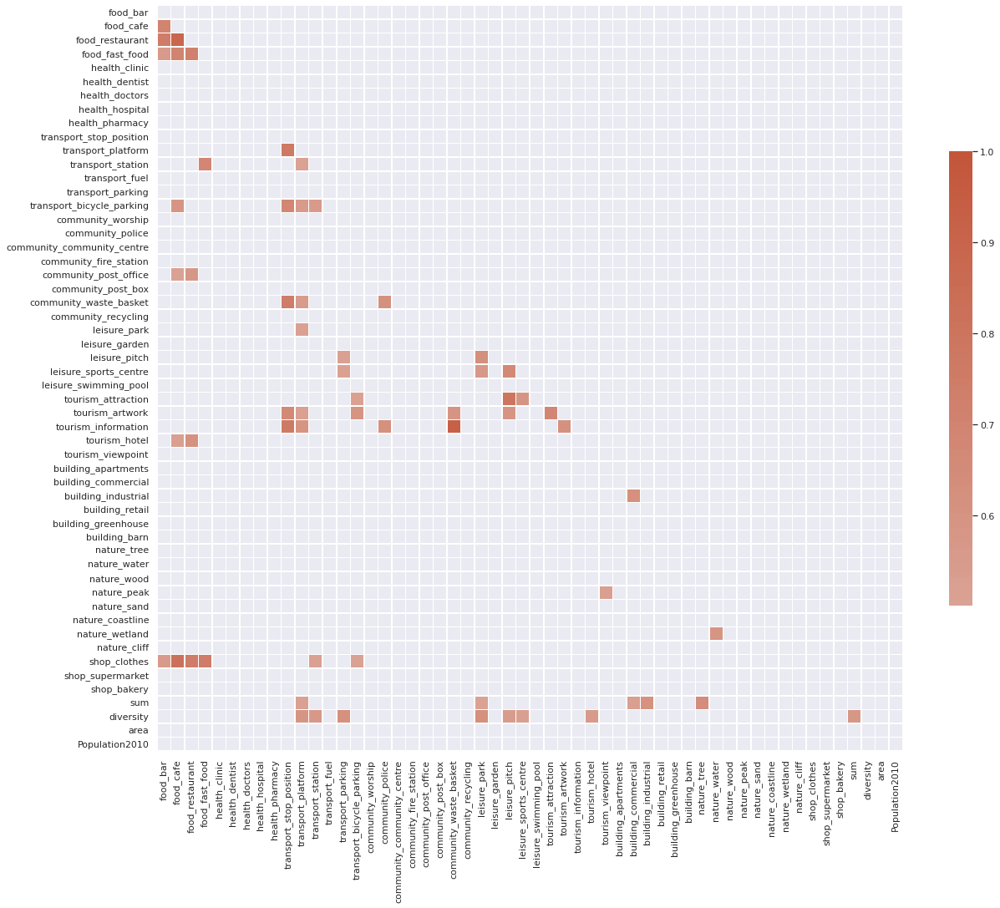

In [ ]:
kot = corr_score[corr_score>=.5]
mask = np.triu(np.ones_like(corr_score, dtype=bool))
plt.figure(figsize=(20,20))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(kot, cmap=cmap, mask=mask,vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [ ]:

import scipy

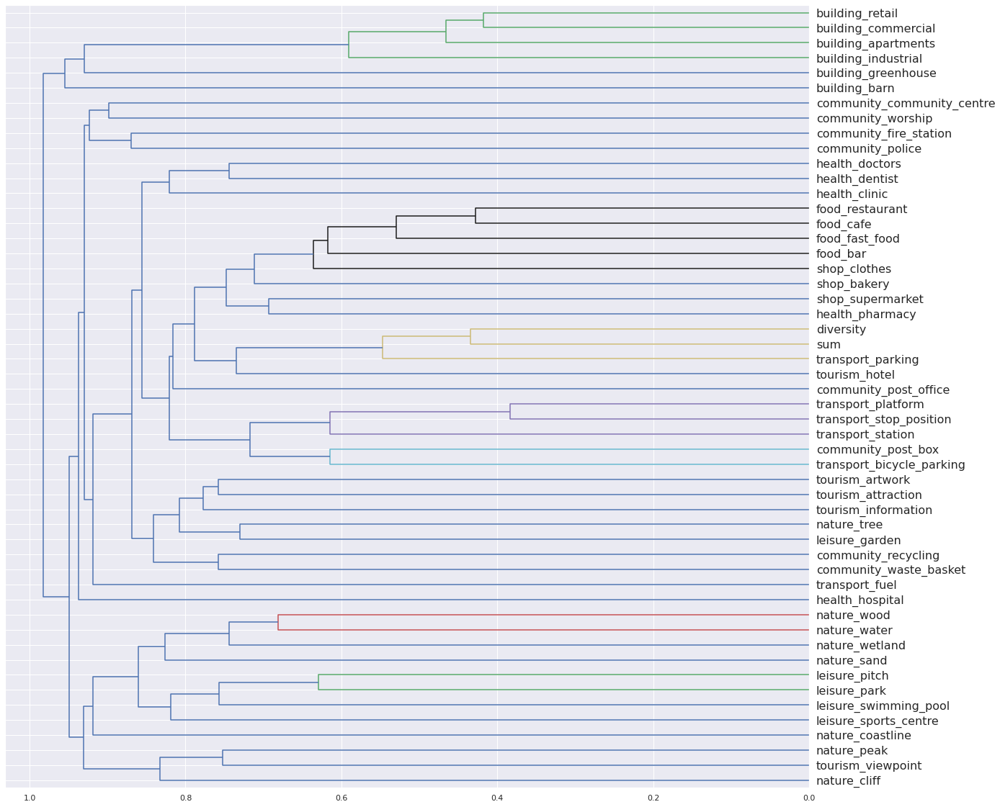

In [ ]:
from scipy.cluster import hierarchy as hc
corr = np.round(scipy.stats.spearmanr(percapita).correlation, 4)
corr_condensed = hc.distance.squareform(1-corr)
z = hc.linkage(corr_condensed, method='average')
fig = plt.figure(figsize=(20,20))
dendrogram = hc.dendrogram(z, labels=percapita.columns,
    orientation='left', leaf_font_size=16)
plt.show()

In [ ]:
corr_score2 = alldata[list(alldata.columns)[54:]].corr()

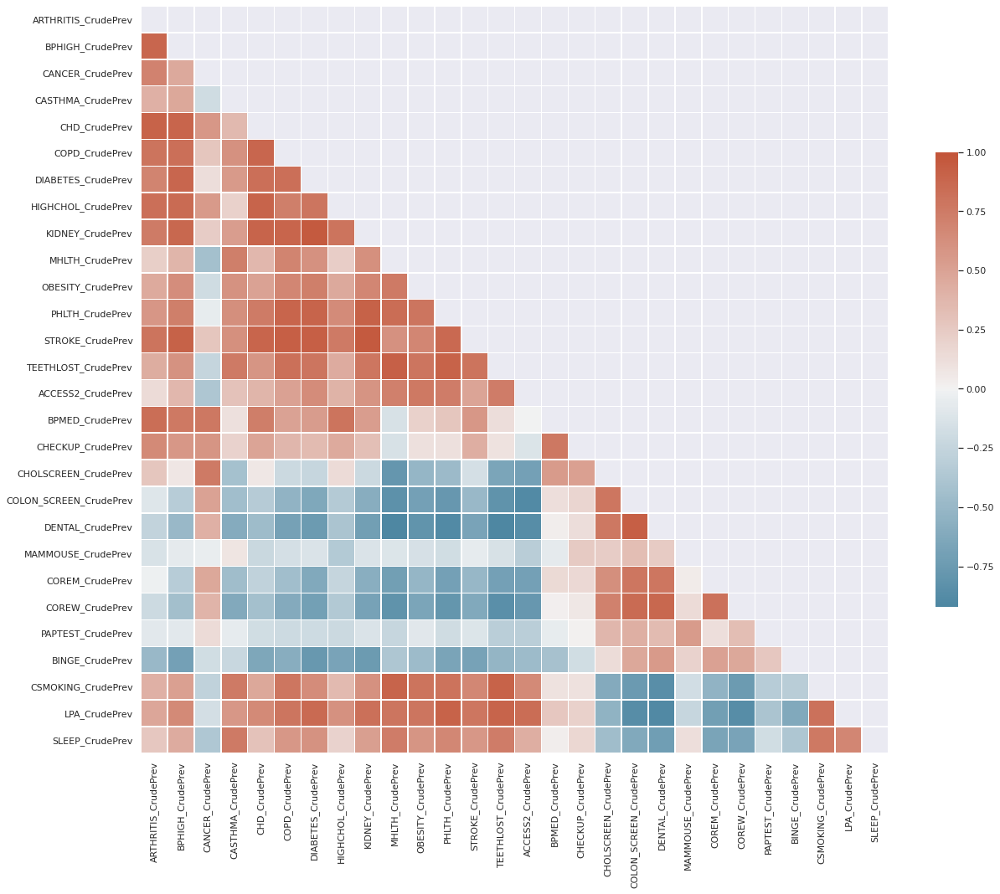

In [ ]:
mask = np.triu(np.ones_like(corr_score2, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 20))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr_score2, mask=mask, cmap=cmap, vmax=1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})